# Practical 1
## MATRIX MULTIPLICATION, EIGEN VECTORS, EIGENVALUE COMPUTATION USING TENSORFLOW

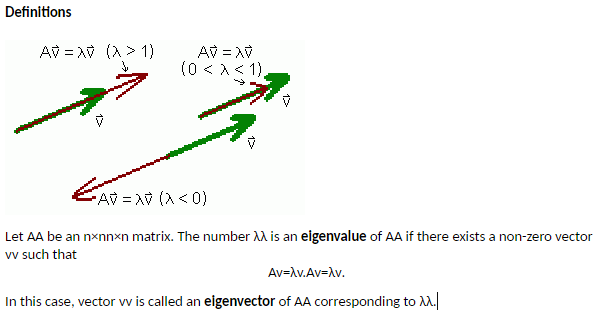

In [ ]:
import tensorflow as tf
print("Matrix Multiplication Demo")

Matrix Multiplication Demo


In [ ]:
x=tf.constant([1,2,3,4,5,6],shape=[2,3])
print(x)

tf.Tensor(
[[1 2 3]
 [4 5 6]], shape=(2, 3), dtype=int32)


In [ ]:
y=tf.constant([7,8,9,10,11,12],shape=[3,2])
print(y)

tf.Tensor(
[[ 7  8]
 [ 9 10]
 [11 12]], shape=(3, 2), dtype=int32)


In [ ]:
z=tf.matmul(x,y)

In [ ]:
print("Product:",z)

Product: tf.Tensor(
[[ 58  64]
 [139 154]], shape=(2, 2), dtype=int32)


In [ ]:
e_matrix_A=tf.random.uniform([2,2],minval=3,maxval=10,dtype=tf.float32,name="matrixA")
print("Matrix A:\n{}\n\n".format(e_matrix_A))

Matrix A:
[[8.7307205 9.0639515]
 [5.393942  9.614674 ]]




In [ ]:
eigen_values_A,eigen_vectors_A=tf.linalg.eigh(e_matrix_A)
print("Eigen Vectors:\n{}\n\nEigen values:\n{}\n".format(eigen_vectors_A, eigen_values_A))

Eigen Vectors:
[[-0.73541343 -0.6776187 ]
 [ 0.6776187  -0.73541343]]

Eigen values:
[ 3.760678 14.584717]



# Practical 2
## Deep Forward Network For XOR

Deep feedforward networks, also often called feedforward neural networks, or multilayer perceptron’s (MLPs), are the quintessential deep learning models. The goal of a feedforward network is to approximate some function f*.<br>
For example, for a classiﬁer, y = f*(x) maps an input x to a category y. A feedforward network deﬁnes a mapping y = f (x; θ) and learns the value of the parameters θ that result in the best function approximation.<br>
These models are called feedforward because information ﬂows through the function being evaluated from x, through the intermediate computations used to deﬁne f, and ﬁnally to the output y. There are no feedback connections in which outputs of the model are fed back into itself.<br>
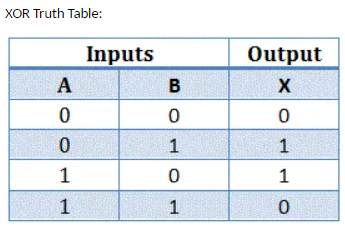

In [ ]:
import numpy as np
from keras.layers import Dense
from keras.models import Sequential

In [ ]:
model=Sequential()
model.add(Dense(units=2,activation='relu',input_dim=2))
model.add(Dense(units=1,activation='sigmoid'))
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
print(model.summary())

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_2 (Dense)             (None, 2)                 6         
                                                                 
 dense_3 (Dense)             (None, 1)                 3         
                                                                 
Total params: 9
Trainable params: 9
Non-trainable params: 0
_________________________________________________________________
None


In [ ]:
print(model.get_weights())

[array([[-0.8435025 , -0.37239122],
       [ 0.34912777, -1.1265315 ]], dtype=float32), array([0., 0.], dtype=float32), array([[-0.24817407],
       [-1.3532746 ]], dtype=float32), array([0.], dtype=float32)]


In [ ]:
X=np.array([[0.,0.],[0.,1.],[1.,0.],[1.,1.]])
Y=np.array([0.,1.,1.,0.])

model.fit(X,Y,epochs=1000,batch_size=4)

Epoch 1/1000
1/1 [==============================] - 1s 1s/step - loss: 0.7042 - accuracy: 0.5000
Epoch 2/1000
1/1 [==============================] - 0s 10ms/step - loss: 0.7041 - accuracy: 0.2500
Epoch 3/1000
1/1 [==============================] - 0s 8ms/step - loss: 0.7040 - accuracy: 0.2500
Epoch 4/1000
1/1 [==============================] - 0s 8ms/step - loss: 0.7039 - accuracy: 0.2500
Epoch 5/1000
1/1 [==============================] - 0s 8ms/step - loss: 0.7038 - accuracy: 0.2500
Epoch 6/1000
1/1 [==============================] - 0s 9ms/step - loss: 0.7036 - accuracy: 0.2500
Epoch 7/1000
1/1 [==============================] - 0s 8ms/step - loss: 0.7035 - accuracy: 0.2500
Epoch 8/1000
1/1 [==============================] - 0s 7ms/step - loss: 0.7034 - accuracy: 0.2500
Epoch 9/1000
1/1 [==============================] - 0s 11ms/step - loss: 0.7033 - accuracy: 0.2500
Epoch 10/1000
1/1 [==============================] - 0s 8ms/step - loss: 0.7032 - accuracy: 0.2500
Epoch 11/1000
1/1 

In [ ]:
print(model.get_weights())

[array([[-0.8435025 , -0.37239122],
       [ 0.16758746, -1.1265315 ]], dtype=float32), array([-0.18154037,  0.        ], dtype=float32), array([[-0.11407749],
       [-1.3532746 ]], dtype=float32), array([2.1596843e-08], dtype=float32)]


In [ ]:
print(model.predict(X,batch_size=4))

[[0.5]
 [0.5]
 [0.5]
 [0.5]]


# PRACTICAL 3A
## CLASSIFICATION USING DNN

Classification neural networks used for feature categorization are very similar to fault-diagnosis networks, except that they only allow one output response for any input pattern, instead of allowing multiple faults to occur for a given set of operating conditions.
The classification network selects the category based on which output response has the highest output value.<br>
<br>
Problem statement:<br> 
The given dataset comprises health information about diabetic women patients. We need to create a deep feed forward network that will classify women suffering from diabetes mellitus as 1.

In [ ]:
from numpy import loadtxt
from keras.models import Sequential
from keras.layers import Dense

In [ ]:
# diabetes.csv download link
# https://drive.google.com/file/d/1V-J7IqOFvYK4zyjUvFGr96Y67bO-7Ydm/view?usp=sharing

In [ ]:
dataset=loadtxt('/content/sample_data/diabetes.csv',delimiter=',', skiprows=1)
print(dataset)

[[  6.    148.     72.    ...   0.627  50.      1.   ]
 [  1.     85.     66.    ...   0.351  31.      0.   ]
 [  8.    183.     64.    ...   0.672  32.      1.   ]
 ...
 [  5.    121.     72.    ...   0.245  30.      0.   ]
 [  1.    126.     60.    ...   0.349  47.      1.   ]
 [  1.     93.     70.    ...   0.315  23.      0.   ]]


In [ ]:
X=dataset[:,0:8]
Y=dataset[:,8]
print(X)

[[  6.    148.     72.    ...  33.6     0.627  50.   ]
 [  1.     85.     66.    ...  26.6     0.351  31.   ]
 [  8.    183.     64.    ...  23.3     0.672  32.   ]
 ...
 [  5.    121.     72.    ...  26.2     0.245  30.   ]
 [  1.    126.     60.    ...  30.1     0.349  47.   ]
 [  1.     93.     70.    ...  30.4     0.315  23.   ]]


In [ ]:
print(Y)

[1. 0. 1. 0. 1. 0. 1. 0. 1. 1. 0. 1. 0. 1. 1. 1. 1. 1. 0. 1. 0. 0. 1. 1.
 1. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 1. 0. 0.
 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0.
 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0.
 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 1. 1. 1. 0. 0. 0.
 1. 0. 0. 0. 1. 1. 0. 0. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.
 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0.
 0. 0. 1. 1. 0. 0. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 0.
 1. 1. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 1.
 1. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 1. 1. 1. 1. 0.
 0. 0. 1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 1. 0. 0.
 1. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 1.
 0. 0. 0. 1. 1. 1. 0. 0. 1. 0. 1. 0. 1. 1. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0.
 1. 0. 1. 0. 0. 1. 0. 1. 0. 1. 1. 1. 0. 0. 1. 0. 1.

In [ ]:
#Creating model
model = Sequential()
model.add(Dense(12, input_dim=8, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

In [ ]:
#Compiling and fitting model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
model.fit(X, Y, epochs=150, batch_size=10)
model.fit(X, Y, epochs=150, batch_size=10)

Epoch 1/150
77/77 [==============================] - 1s 2ms/step - loss: 4.2733 - accuracy: 0.5039
Epoch 2/150
77/77 [==============================] - 0s 2ms/step - loss: 1.3494 - accuracy: 0.5703
Epoch 3/150
77/77 [==============================] - 0s 2ms/step - loss: 1.1380 - accuracy: 0.5703
Epoch 4/150
77/77 [==============================] - 0s 2ms/step - loss: 1.0105 - accuracy: 0.5872
Epoch 5/150
77/77 [==============================] - 0s 2ms/step - loss: 0.9825 - accuracy: 0.5964
Epoch 6/150
77/77 [==============================] - 0s 2ms/step - loss: 0.9140 - accuracy: 0.6094
Epoch 7/150
77/77 [==============================] - 0s 2ms/step - loss: 0.8947 - accuracy: 0.6367
Epoch 8/150
77/77 [==============================] - 0s 2ms/step - loss: 0.8218 - accuracy: 0.6419
Epoch 9/150
77/77 [==============================] - 0s 2ms/step - loss: 0.8177 - accuracy: 0.6406
Epoch 10/150
77/77 [==============================] - 0s 2ms/step - loss: 0.7770 - accuracy: 0.6549
Epoch 11/

In [ ]:
predictions = model.predict(X)
rounded = [round(x[0]) for x in predictions]
print(rounded)

[1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 

In [ ]:
scores = model.evaluate(X, Y)
print("\n%s: %.2f%%" % (model.metrics_names[1], scores[1]*100))

24/24 [==============================] - 0s 4ms/step - loss: 0.4620 - accuracy: 0.7826

accuracy: 78.26%


# PRACTICAL 3B
## BINARY CLASSIFICATION USING MLP

Multilayer Perceptron falls under the category of feedforward algorithms, because inputs are combined with the initial weights in a weighted sum and subjected to the activation function, just like in the Perceptron. But the difference is that each linear combination is propagated to the next layer.
Each layer is feeding the next one with the result of their computation, their internal representation of the data. This goes all the way through the hidden layers to the output layer.
<br>
Binary classification, which looks at an input and predicts which of two possible classes it belongs to. Practical uses include sentiment analysis, spam detection, and credit-card fraud detection. Such models are trained with datasets labelled with 1s and 0s representing the two classes, employ popular learning algorithms such as logistic regression and Naïve Bayes, and are frequently built with libraries such as Scikit-learn.

In [ ]:
# mlp for binary classification
from pandas import read_csv
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense

In [ ]:
# Ionosphere.csv download link
# https://drive.google.com/file/d/1youDnAIZdWTybK9gAkSpsWp5zgismVjS/view?usp=sharing

In [ ]:
# load the dataset
path = '/content/sample_data/Ionosphere.csv'
df = read_csv(path, header=None, skiprows=1)

In [ ]:
# split into input and output columns
X, y = df.values[:, :-1], df.values[:, -1]
# ensure all data are floating point values
X = X.astype('float32')
# encode strings to integer
y = LabelEncoder().fit_transform(y)
# split into train and test datasets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33)
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)
# determine the number of input features
n_features = X_train.shape[1]
# define model
model = Sequential()
model.add(Dense(10, activation='relu', kernel_initializer='he_normal', input_shape=(n_features,)))
model.add(Dense(8, activation='relu', kernel_initializer='he_normal'))
model.add(Dense(1, activation='sigmoid'))
# compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
# fit the model
model.fit(X_train, y_train, epochs=150, batch_size=32, verbose=0)

(235, 34) (116, 34) (235,) (116,)


In [ ]:
# evaluate the model
loss, acc = model.evaluate(X_test, y_test, verbose=0)
print('Test Accuracy: %.3f' % acc)

Test Accuracy: 0.966


In [ ]:
# make a prediction
row = [1,0,0.99539,-0.05889,0.85243,0.02306,0.83398,-0.37708,1,0.03760,0.85243,-0.17755,0.59755,-0.44945,0.60536,-0.38223,0.84356,-0.38542,0.58212,-0.32192,0.56971,-0.29674,0.36946,-0.47357,0.56811,-0.51171,0.41078,-0.46168,0.21266,-0.34090,0.42267,-0.54487,0.18641,-0.45300]
yhat = model.predict([row])
print('Predicted: %.3f' % yhat)

Predicted: 0.985


# PRACTICAL 4
## PREDICTING THE PROBABILITY OF THE CLASS

In [ ]:
from keras.models import Sequential
from keras.layers import Dense
from sklearn.datasets import make_blobs
from sklearn.preprocessing import MinMaxScaler

In [ ]:
X,Y=make_blobs(n_samples=100,centers=2,n_features=2,random_state=1)
scalar=MinMaxScaler()
scalar.fit(X)
X=scalar.transform(X)

In [ ]:
model=Sequential()
model.add(Dense(4,input_dim=2,activation='relu'))
model.add(Dense(4,activation='relu'))
model.add(Dense(1,activation='sigmoid'))
model.compile(loss='binary_crossentropy',optimizer='adam')
model.fit(X,Y,epochs=500)

Epoch 1/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7692
Epoch 2/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7651
Epoch 3/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7616
Epoch 4/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7577
Epoch 5/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7544
Epoch 6/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7509
Epoch 7/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7478
Epoch 8/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7450
Epoch 9/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7417
Epoch 10/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7388
Epoch 11/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7358
Epoch 12/500
4/4 [==============================] - 0s 2ms/step - loss: 0.7326
Epoch 13/500
4/4 [==============================] - 0s 2ms/st

In [ ]:
Xnew,Yreal=make_blobs(n_samples=3,centers=2,n_features=2,random_state=1)
Xnew=scalar.transform(Xnew)
Yclass=model.predict(Xnew)
Ynew=model.predict(Xnew)

In [ ]:
for i in range(len(Xnew)):
  print("X=%s,Predicted_probability=%s,Predicted_class=%s"%(Xnew[i],Ynew[i],Yclass[i]))

X=[0.89337759 0.65864154],Predicted_probability=[0.00376934],Predicted_class=[0.00376934]
X=[0.29097707 0.12978982],Predicted_probability=[0.81591594],Predicted_class=[0.81591594]
X=[0.78082614 0.75391697],Predicted_probability=[0.00787392],Predicted_class=[0.00787392]


# PRACTICAL 5A
## CNN FOR CIFAR10 IMAGES

A neural network in which at least one layer is a convolutional layer. A typical convolutional neural network consists of some combination of the following layers:
- convolutional layers
- pooling layers
- dense layers
<br>
Convolutional neural networks have had great success in certain kinds of problems, such as image recognition.

In [ ]:
import tensorflow as tf
from tensorflow.keras import datasets, layers, models
import matplotlib.pyplot as plt

In [ ]:
(train_images, train_labels), (test_images, test_labels) = datasets.cifar10.load_data()
# Normalize pixel values to be between 0 and 1
train_images, test_images = train_images / 255.0, test_images / 255.0

170508288/170498071 [==============================] - 7s 0us/step


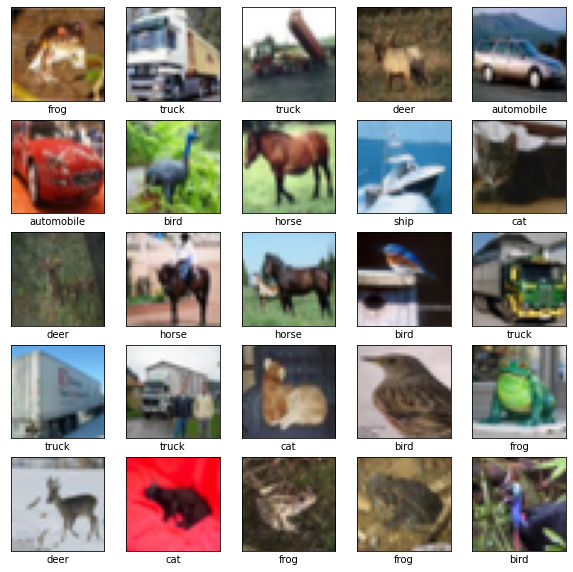

In [ ]:
class_names = ['airplane', 'automobile', 'bird', 'cat', 'deer',
               'dog', 'frog', 'horse', 'ship', 'truck']
plt.figure(figsize=(10,10))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(train_images[i])
    # The CIFAR labels happen to be arrays, 
    # which is why you need the extra index
    plt.xlabel(class_names[train_labels[i][0]])
plt.show()

In [ ]:
model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(32, 32, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 30, 30, 32)        896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 15, 15, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 13, 13, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 6, 6, 64)         0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 4, 4, 64)          36928     
                                                                 
Total params: 56,320
Trainable params: 56,320
Non-trai

In [ ]:
model.add(layers.Flatten())
model.add(layers.Dense(64, activation='relu'))
model.add(layers.Dense(10))
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 30, 30, 32)        896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 15, 15, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 13, 13, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 6, 6, 64)         0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 4, 4, 64)          36928     
                                                                 
 flatten (Flatten)           (None, 1024)             

In [ ]:
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
history = model.fit(train_images, train_labels, epochs=10, 
                    validation_data=(test_images, test_labels))

Epoch 1/10
1563/1563 [==============================] - 43s 28ms/step - loss: 0.5349 - accuracy: 0.8113 - val_loss: 0.8688 - val_accuracy: 0.7212
Epoch 2/10
1563/1563 [==============================] - 44s 28ms/step - loss: 0.4958 - accuracy: 0.8240 - val_loss: 0.9234 - val_accuracy: 0.7127
Epoch 3/10
1563/1563 [==============================] - 43s 28ms/step - loss: 0.4615 - accuracy: 0.8355 - val_loss: 0.9227 - val_accuracy: 0.7194
Epoch 4/10
1563/1563 [==============================] - 43s 28ms/step - loss: 0.4303 - accuracy: 0.8475 - val_loss: 0.9697 - val_accuracy: 0.7121
Epoch 5/10
1563/1563 [==============================] - 44s 28ms/step - loss: 0.4006 - accuracy: 0.8571 - val_loss: 1.0437 - val_accuracy: 0.7037
Epoch 6/10
1563/1563 [==============================] - 43s 28ms/step - loss: 0.3716 - accuracy: 0.8672 - val_loss: 1.0158 - val_accuracy: 0.7122
Epoch 7/10
1563/1563 [==============================] - 44s 28ms/step - loss: 0.3449 - accuracy: 0.8784 - val_loss: 1.0961 -

313/313 - 2s - loss: 1.2522 - accuracy: 0.7043 - 2s/epoch - 7ms/step


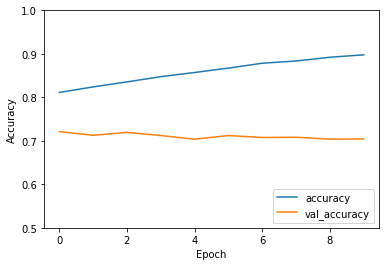

In [ ]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label ='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0.5,1])
plt.legend(loc='lower right')
test_loss,test_acc=model.evaluate(test_images, test_labels, verbose=2)

In [ ]:
print(test_acc)

0.7042999863624573


# PRACTICAL 5B
## IMAGE CLASSIFICATION

We will classify images of flowers. It creates an image classifier using a tf.keras.Sequential model, and loads data using tf.keras.utils.image_dataset_from_directory. You will gain practical experience with the following concepts:
1. Efficiently loading a dataset off disk.
2. Identifying overfitting and applying techniques to mitigate it, including data augmentation and dropout.
3. Examine and understand data
4. Build an input pipeline
5. Build the model
6. Train the model
7. Test the model
8. Improve the model and repeat the process

This dataset is of about 3,700 photos of flowers. The dataset contains five sub-directories, one per class:
- flower_photo
  1. daisy
  2. dandelion
  3. roses
  4. sunflowers
  5. tulips

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential

In [ ]:
import pathlib
dataset_url = "https://storage.googleapis.com/download.tensorflow.org/example_images/flower_photos.tgz"
data_dir = tf.keras.utils.get_file('flower_photos', origin=dataset_url, untar=True)
data_dir = pathlib.Path(data_dir)

228827136/228813984 [==============================] - 1s 0us/step


In [ ]:
image_count = len(list(data_dir.glob('*/*.jpg')))
print(image_count)

3670


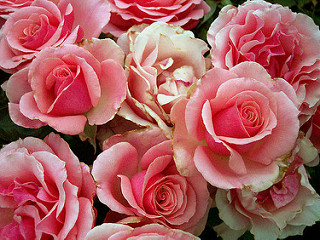

In [ ]:
roses = list(data_dir.glob('roses/*'))
PIL.Image.open(str(roses[0]))

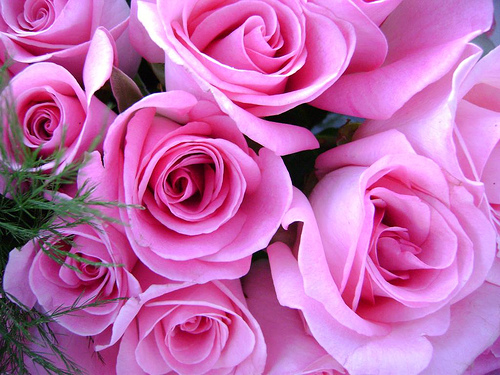

In [ ]:
PIL.Image.open(str(roses[1]))

In [ ]:
tulips = list(data_dir.glob('tulips/*'))

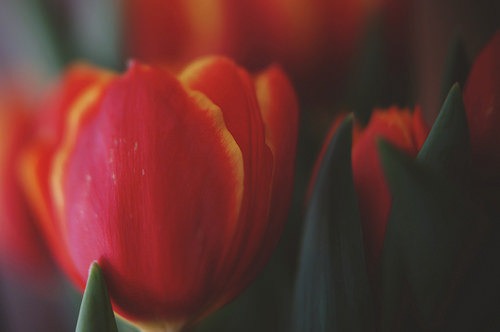

In [ ]:
PIL.Image.open(str(tulips[0]))

In [ ]:
batch_size = 32
img_height = 180
img_width = 180
train_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset="training",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 3670 files belonging to 5 classes.
Using 2936 files for training.


In [ ]:
val_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset="validation",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 3670 files belonging to 5 classes.
Using 734 files for validation.


In [ ]:
class_names = train_ds.class_names
print(class_names)

['daisy', 'dandelion', 'roses', 'sunflowers', 'tulips']


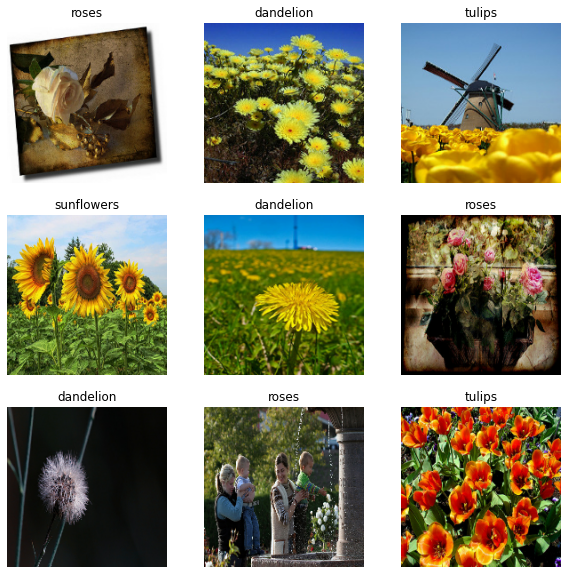

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10,10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax=plt.subplot(3,3,i+1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

In [ ]:
for image_batch, labels_batch in train_ds:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(32, 180, 180, 3)
(32,)


In [ ]:
AUTOTUNE = tf.data.AUTOTUNE

train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)
normalization_layer = layers.Rescaling(1./255)

normalized_ds = train_ds.map(lambda x, y: (normalization_layer(x), y))
image_batch, labels_batch = next(iter(normalized_ds))
first_image = image_batch[0]
# Notice the pixel values are now in `[0,1]`.
print(np.min(first_image), np.max(first_image))

0.0 1.0


In [ ]:
num_classes = 5

model = Sequential([
  layers.Rescaling(1./255, input_shape=(img_height, img_width, 3)),
  layers.Conv2D(16, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(32, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(64, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Flatten(),
  layers.Dense(128, activation='relu'),
  layers.Dense(num_classes)
])

model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [ ]:
model.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling_1 (Rescaling)     (None, 180, 180, 3)       0         
                                                                 
 conv2d_3 (Conv2D)           (None, 180, 180, 16)      448       
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 90, 90, 16)       0         
 2D)                                                             
                                                                 
 conv2d_4 (Conv2D)           (None, 90, 90, 32)        4640      
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 45, 45, 32)       0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 45, 45, 64)       

In [ ]:
epochs=10
history = model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

Epoch 1/10
92/92 [==============================] - 58s 626ms/step - loss: 1.3771 - accuracy: 0.4022 - val_loss: 1.1025 - val_accuracy: 0.5204
Epoch 2/10
92/92 [==============================] - 56s 611ms/step - loss: 1.0390 - accuracy: 0.5817 - val_loss: 0.9787 - val_accuracy: 0.6104
Epoch 3/10
92/92 [==============================] - 56s 611ms/step - loss: 0.8589 - accuracy: 0.6717 - val_loss: 0.8943 - val_accuracy: 0.6512
Epoch 4/10
92/92 [==============================] - 57s 622ms/step - loss: 0.6707 - accuracy: 0.7466 - val_loss: 0.8915 - val_accuracy: 0.6689
Epoch 5/10
92/92 [==============================] - 56s 614ms/step - loss: 0.4730 - accuracy: 0.8317 - val_loss: 1.0263 - val_accuracy: 0.6431
Epoch 6/10
92/92 [==============================] - 57s 623ms/step - loss: 0.3004 - accuracy: 0.8934 - val_loss: 1.1866 - val_accuracy: 0.6444
Epoch 7/10
92/92 [==============================] - 57s 619ms/step - loss: 0.1637 - accuracy: 0.9506 - val_loss: 1.2467 - val_accuracy: 0.6526

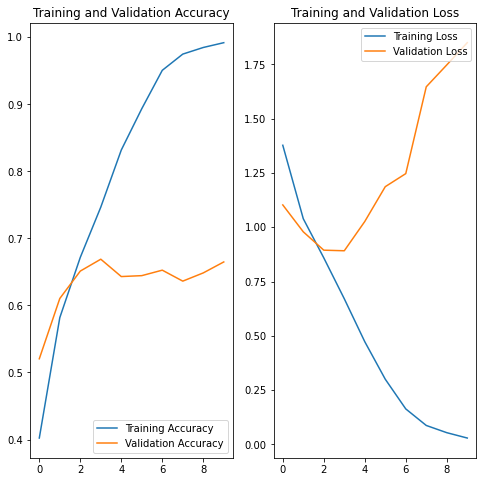

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

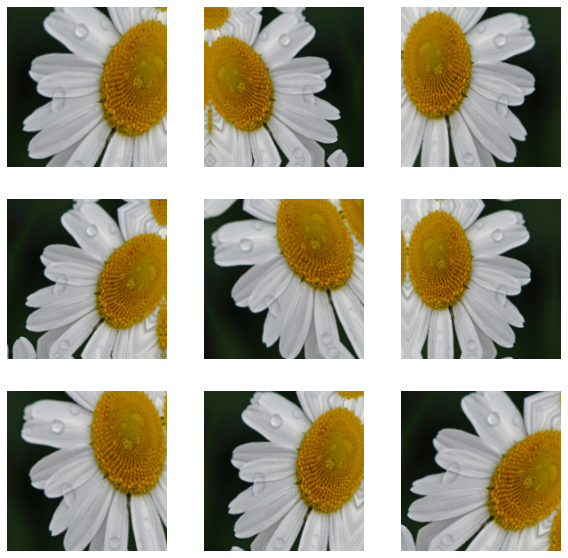

In [ ]:
data_augmentation = keras.Sequential(
  [
    layers.RandomFlip("horizontal",
                      input_shape=(img_height,
                                  img_width,
                                  3)),
    layers.RandomRotation(0.1),
    layers.RandomZoom(0.1),
  ]
)
plt.figure(figsize=(10, 10))
for images, _ in train_ds.take(1):
  for i in range(9):
    augmented_images = data_augmentation(images)
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(augmented_images[0].numpy().astype("uint8"))
    plt.axis("off")

In [ ]:
model = Sequential([
  data_augmentation,
  layers.Rescaling(1./255),
  layers.Conv2D(16, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(32, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(64, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Dropout(0.2),
  layers.Flatten(),
  layers.Dense(128, activation='relu'),
  layers.Dense(num_classes)
])

In [ ]:
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [ ]:
model.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_5 (Sequential)   (None, 180, 180, 3)       0         
                                                                 
 rescaling_2 (Rescaling)     (None, 180, 180, 3)       0         
                                                                 
 conv2d_6 (Conv2D)           (None, 180, 180, 16)      448       
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 90, 90, 16)       0         
 2D)                                                             
                                                                 
 conv2d_7 (Conv2D)           (None, 90, 90, 32)        4640      
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 45, 45, 32)       0         
 2D)                                                  

In [ ]:
epochs = 15
history = model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

Epoch 1/15
92/92 [==============================] - 67s 720ms/step - loss: 1.2278 - accuracy: 0.4871 - val_loss: 1.1331 - val_accuracy: 0.5545
Epoch 2/15
92/92 [==============================] - 65s 709ms/step - loss: 0.9825 - accuracy: 0.6185 - val_loss: 0.9444 - val_accuracy: 0.6308
Epoch 3/15
92/92 [==============================] - 66s 719ms/step - loss: 0.9155 - accuracy: 0.6461 - val_loss: 0.9042 - val_accuracy: 0.6471
Epoch 4/15
92/92 [==============================] - 65s 709ms/step - loss: 0.8424 - accuracy: 0.6778 - val_loss: 0.8845 - val_accuracy: 0.6390
Epoch 5/15
92/92 [==============================] - 66s 716ms/step - loss: 0.7853 - accuracy: 0.6921 - val_loss: 0.7714 - val_accuracy: 0.6853
Epoch 6/15
92/92 [==============================] - 65s 708ms/step - loss: 0.7396 - accuracy: 0.7228 - val_loss: 0.7485 - val_accuracy: 0.7071
Epoch 7/15
92/92 [==============================] - 65s 709ms/step - loss: 0.7068 - accuracy: 0.7268 - val_loss: 0.7256 - val_accuracy: 0.6921

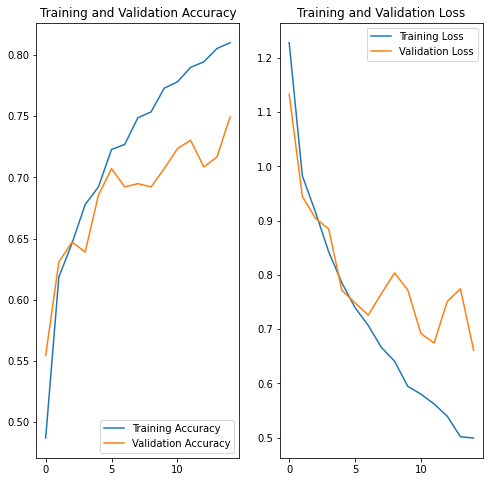

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

In [ ]:
sunflower_url = "https://storage.googleapis.com/download.tensorflow.org/example_images/592px-Red_sunflower.jpg"
sunflower_path = tf.keras.utils.get_file('Red_sunflower', origin=sunflower_url)

img = tf.keras.utils.load_img(
    sunflower_path, target_size=(img_height, img_width)
)

img_array = tf.keras.utils.img_to_array(img)
img_array = tf.expand_dims(img_array, 0) # Create a batch

predictions = model.predict(img_array)
score = tf.nn.softmax(predictions[0])

131072/117948 [=================================] - 0s 0us/step


In [ ]:
print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(class_names[np.argmax(score)], 100 * np.max(score))
)

This image most likely belongs to sunflowers with a 96.21 percent confidence.


# PRACTICAL 5C
## DATA AUGMENTATION

Data augmentation is a strategy that enables practitioners to significantly increase the diversity of data available for training models, without actually collecting new data. Data augmentation techniques such as cropping, padding, and horizontal flipping are commonly used to train large neural networks.

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
import tensorflow_datasets as tfds

In [ ]:
from tensorflow.keras import layers
(train_ds, val_ds, test_ds), metadata = tfds.load(
    'tf_flowers',
    split=['train[:80%]', 'train[80%:90%]', 'train[90%:]'],
    with_info=True,
    as_supervised=True,
)

Dl Completed...:   0%|          | 0/5 [00:00<?, ? file/s]

Dataset tf_flowers downloaded and prepared to ~/tensorflow_datasets/tf_flowers/3.0.1. Subsequent calls will reuse this data.


In [ ]:
num_classes = metadata.features['label'].num_classes
print(num_classes)

5


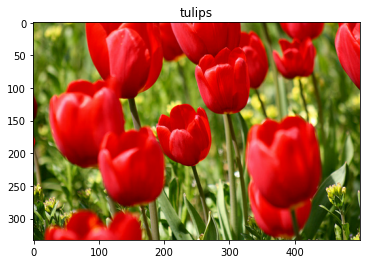

In [ ]:
get_label_name = metadata.features['label'].int2str

image, label = next(iter(train_ds))
_ = plt.imshow(image)
_ = plt.title(get_label_name(label))

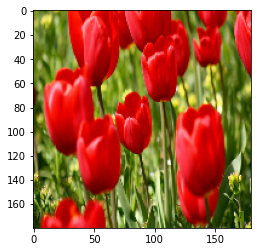

In [ ]:
IMG_SIZE = 180

resize_and_rescale = tf.keras.Sequential([
  layers.Resizing(IMG_SIZE, IMG_SIZE),
  layers.Rescaling(1./255)
])
result = resize_and_rescale(image)
_ = plt.imshow(result)

In [ ]:
print("Min and max pixel values:", result.numpy().min(), result.numpy().max())

Min and max pixel values: 0.0 1.0


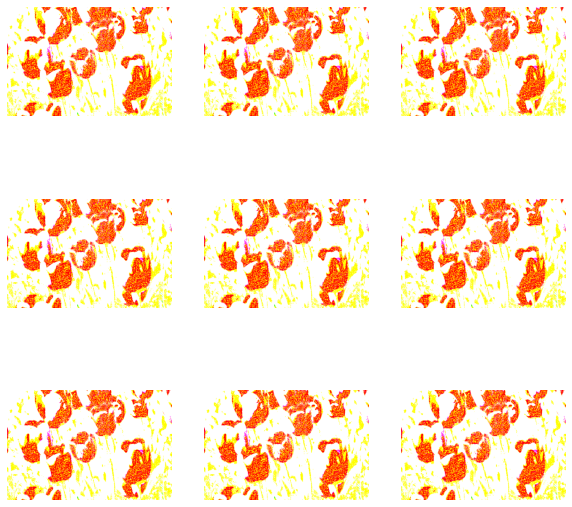

In [ ]:
data_augmentation = tf.keras.Sequential([
  layers.RandomFlip("horizontal_and_vertical"),
  layers.RandomRotation(0.2),
])
# Add the image to a batch.
image = tf.expand_dims(image, 0)
plt.figure(figsize=(10, 10))
for i in range(9):
  augmented_image = data_augmentation(image)
  ax = plt.subplot(3, 3, i + 1)
  plt.imshow(augmented_image[0])
  plt.axis("off")

In [ ]:
model = tf.keras.Sequential([
  # Add the preprocessing layers you created earlier.
  resize_and_rescale,
  data_augmentation,
  layers.Conv2D(16, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  # Rest of your model.
])

In [ ]:
aug_ds = train_ds.map(
  lambda x, y: (resize_and_rescale(x, training=True), y))
batch_size = 32
AUTOTUNE = tf.data.AUTOTUNE

def prepare(ds, shuffle=False, augment=False):
  # Resize and rescale all datasets.
  ds = ds.map(lambda x, y: (resize_and_rescale(x), y), 
              num_parallel_calls=AUTOTUNE)

  if shuffle:
    ds = ds.shuffle(1000)
    
  # Batch all datasets.
  ds = ds.batch(batch_size)

  # Use data augmentation only on the training set.
  if augment:
    ds = ds.map(lambda x, y: (data_augmentation(x, training=True), y), 
                num_parallel_calls=AUTOTUNE)

  # Use buffered prefetching on all datasets.
  return ds.prefetch(buffer_size=AUTOTUNE)

In [ ]:
train_ds = prepare(train_ds, shuffle=True, augment=True)
val_ds = prepare(val_ds)
test_ds = prepare(test_ds)

model = tf.keras.Sequential([
  layers.Conv2D(16, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(32, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(64, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Flatten(),
  layers.Dense(128, activation='relu'),
  layers.Dense(num_classes)
])
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [ ]:
epochs=5
history = model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

Epoch 1/5
92/92 [==============================] - 65s 680ms/step - loss: 1.4067 - accuracy: 0.3971 - val_loss: 1.2178 - val_accuracy: 0.5123
Epoch 2/5
92/92 [==============================] - 61s 652ms/step - loss: 1.1268 - accuracy: 0.5364 - val_loss: 1.1275 - val_accuracy: 0.5286
Epoch 3/5
92/92 [==============================] - 62s 663ms/step - loss: 1.0204 - accuracy: 0.5950 - val_loss: 0.9355 - val_accuracy: 0.6458
Epoch 4/5
92/92 [==============================] - 61s 652ms/step - loss: 0.9607 - accuracy: 0.6213 - val_loss: 0.9732 - val_accuracy: 0.6349
Epoch 5/5
92/92 [==============================] - 61s 659ms/step - loss: 0.8926 - accuracy: 0.6543 - val_loss: 0.9574 - val_accuracy: 0.6185


In [ ]:
loss, acc = model.evaluate(test_ds)
print("Accuracy", acc)

12/12 [==============================] - 3s 199ms/step - loss: 0.8842 - accuracy: 0.6512
Accuracy 0.6512261629104614


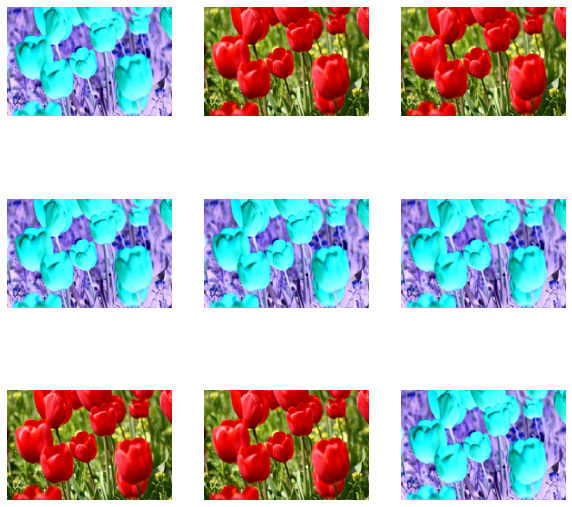

In [ ]:
def random_invert_img(x, p=0.5):
  if  tf.random.uniform([]) < p:
    x = (255-x)
  else:
    x
  return x
def random_invert(factor=0.5):
  return layers.Lambda(lambda x: random_invert_img(x, factor))

random_invert = random_invert()
plt.figure(figsize=(10, 10))
for i in range(9):
  augmented_image = random_invert(image)
  ax = plt.subplot(3, 3, i + 1)
  plt.imshow(augmented_image[0].numpy().astype("uint8"))
  plt.axis("off")

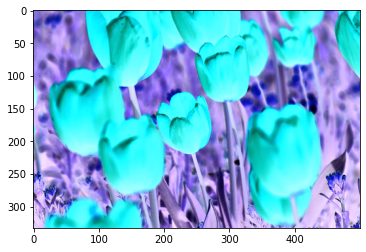

In [ ]:
class RandomInvert(layers.Layer):
  def __init__(self, factor=0.5, **kwargs):
    super().__init__(**kwargs)
    self.factor = factor

  def call(self, x):
    return random_invert_img(x)
_ = plt.imshow(RandomInvert()(image)[0])

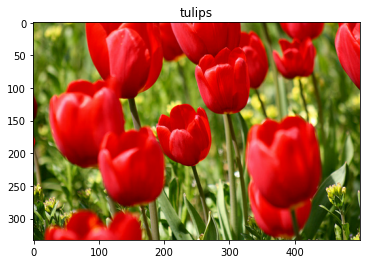

In [ ]:
(train_ds, val_ds, test_ds), metadata = tfds.load(
    'tf_flowers',
    split=['train[:80%]', 'train[80%:90%]', 'train[90%:]'],
    with_info=True,
    as_supervised=True,
)
image, label = next(iter(train_ds))
_ = plt.imshow(image)
_ = plt.title(get_label_name(label))

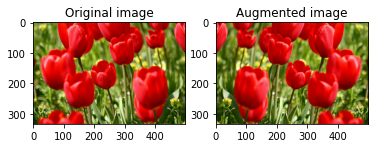

In [ ]:
def visualize(original, augmented):
  fig = plt.figure()
  plt.subplot(1,2,1)
  plt.title('Original image')
  plt.imshow(original)

  plt.subplot(1,2,2)
  plt.title('Augmented image')
  plt.imshow(augmented)
flipped = tf.image.flip_left_right(image)
visualize(image, flipped)

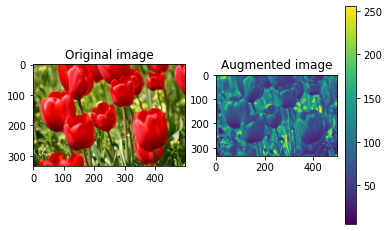

In [ ]:
grayscaled = tf.image.rgb_to_grayscale(image)
visualize(image, tf.squeeze(grayscaled))
_ = plt.colorbar()

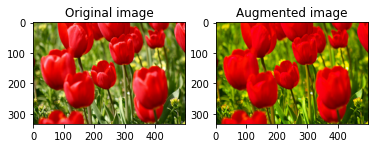

In [ ]:
saturated = tf.image.adjust_saturation(image, 3)
visualize(image, saturated)

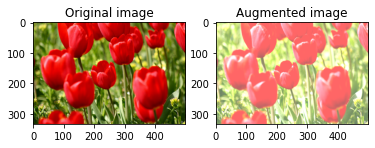

In [ ]:
bright = tf.image.adjust_brightness(image, 0.4)
visualize(image, bright)

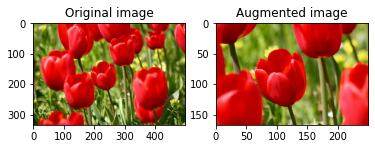

In [ ]:
cropped = tf.image.central_crop(image, central_fraction=0.5)
visualize(image,cropped)

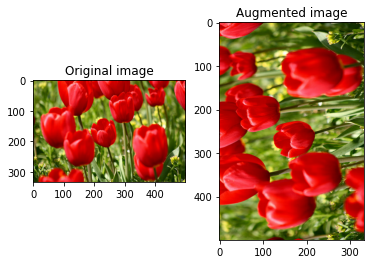

In [ ]:
rotated = tf.image.rot90(image)
visualize(image, rotated)

# PRACTICAL 6
## BUILDING RNN USING SINGLE NEURON

Recurrent neural networks (RNN) are a class of neural networks that is powerful for modeling sequence data such as time series or natural language.
Schematically, a RNN layer uses a for loop to iterate over the timesteps of a sequence, while maintaining an internal state that encodes information about the timesteps it has seen so far.
The Keras RNN API is designed with a focus on: <br>
**Ease of use:** the built-in keras.layers.RNN, keras. layers.LSTM, keras.layers.GRU layers enable you to quickly build recurrent models without having to make difficult configuration choices.

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

In [ ]:
model = keras.Sequential()
# Add an Embedding layer expecting input vocab of size 1000, and
# output embedding dimension of size 64.
model.add(layers.Embedding(input_dim=1000, output_dim=64))
# Add a LSTM layer with 128 internal units.
model.add(layers.LSTM(128))
# Add a Dense layer with 10 units.
model.add(layers.Dense(10))

model.summary()

Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, None, 64)          64000     
                                                                 
 lstm (LSTM)                 (None, 128)               98816     
                                                                 
 dense_17 (Dense)            (None, 10)                1290      
                                                                 
Total params: 164,106
Trainable params: 164,106
Non-trainable params: 0
_________________________________________________________________


In [ ]:
model = keras.Sequential()
model.add(layers.Embedding(input_dim=1000, output_dim=64))

# The output of GRU will be a 3D tensor of shape (batch_size, timesteps, 256)
model.add(layers.GRU(256, return_sequences=True))

# The output of SimpleRNN will be a 2D tensor of shape (batch_size, 128)
model.add(layers.SimpleRNN(128))

model.add(layers.Dense(10))

model.summary()

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_1 (Embedding)     (None, None, 64)          64000     
                                                                 
 gru (GRU)                   (None, None, 256)         247296    
                                                                 
 simple_rnn (SimpleRNN)      (None, 128)               49280     
                                                                 
 dense_18 (Dense)            (None, 10)                1290      
                                                                 
Total params: 361,866
Trainable params: 361,866
Non-trainable params: 0
_________________________________________________________________


In [ ]:
encoder_vocab = 1000
decoder_vocab = 2000

encoder_input = layers.Input(shape=(None,))
encoder_embedded = layers.Embedding(input_dim=encoder_vocab, output_dim=64)(
    encoder_input
)

In [ ]:
# Return states in addition to output
output, state_h, state_c = layers.LSTM(64, return_state=True, name="encoder")(
    encoder_embedded
)

In [ ]:
encoder_state = [state_h, state_c]

decoder_input = layers.Input(shape=(None,))
decoder_embedded = layers.Embedding(input_dim=decoder_vocab, output_dim=64)(
    decoder_input
)

In [ ]:
# Pass the 2 states to a new LSTM layer, as initial state
decoder_output = layers.LSTM(64, name="decoder")(
    decoder_embedded, initial_state=encoder_state
)
output = layers.Dense(10)(decoder_output)

In [ ]:
model = keras.Model([encoder_input, decoder_input], output)
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None)]       0           []                               
                                                                                                  
 input_2 (InputLayer)           [(None, None)]       0           []                               
                                                                                                  
 embedding_2 (Embedding)        (None, None, 64)     64000       ['input_1[0][0]']                
                                                                                                  
 embedding_3 (Embedding)        (None, None, 64)     128000      ['input_2[0][0]']                
                                                                                              

# PRACTICAL 7
## NLP CORPUS

### GUTENBERG

In [ ]:
import nltk

In [ ]:
nltk.__file__

'/usr/local/lib/python3.7/dist-packages/nltk/__init__.py'

In [ ]:
nltk.download('popular')

In [ ]:
nltk.download('gutenberg')

[nltk_data] Downloading package gutenberg to /root/nltk_data...
[nltk_data]   Package gutenberg is already up-to-date!


True

In [ ]:
from nltk.corpus import gutenberg

In [ ]:
#read single file
gutenberg.raw('austen-emma.txt')

'[Emma by Jane Austen 1816]\n\nVOLUME I\n\nCHAPTER I\n\n\nEmma Woodhouse, handsome, clever, and rich, with a comfortable home\nand happy disposition, seemed to unite some of the best blessings\nof existence; and had lived nearly twenty-one years in the world\nwith very little to distress or vex her.\n\nShe was the youngest of the two daughters of a most affectionate,\nindulgent father; and had, in consequence of her sister\'s marriage,\nbeen mistress of his house from a very early period.  Her mother\nhad died too long ago for her to have more than an indistinct\nremembrance of her caresses; and her place had been supplied\nby an excellent woman as governess, who had fallen little short\nof a mother in affection.\n\nSixteen years had Miss Taylor been in Mr. Woodhouse\'s family,\nless as a governess than a friend, very fond of both daughters,\nbut particularly of Emma.  Between _them_ it was more the intimacy\nof sisters.  Even before Miss Taylor had ceased to hold the nominal\noffice o

In [ ]:
#read miltiple files
gutenberg.raw(['austen-emma.txt','austen-sense.txt'])

'[Emma by Jane Austen 1816]\n\nVOLUME I\n\nCHAPTER I\n\n\nEmma Woodhouse, handsome, clever, and rich, with a comfortable home\nand happy disposition, seemed to unite some of the best blessings\nof existence; and had lived nearly twenty-one years in the world\nwith very little to distress or vex her.\n\nShe was the youngest of the two daughters of a most affectionate,\nindulgent father; and had, in consequence of her sister\'s marriage,\nbeen mistress of his house from a very early period.  Her mother\nhad died too long ago for her to have more than an indistinct\nremembrance of her caresses; and her place had been supplied\nby an excellent woman as governess, who had fallen little short\nof a mother in affection.\n\nSixteen years had Miss Taylor been in Mr. Woodhouse\'s family,\nless as a governess than a friend, very fond of both daughters,\nbut particularly of Emma.  Between _them_ it was more the intimacy\nof sisters.  Even before Miss Taylor had ceased to hold the nominal\noffice o

In [ ]:
nltk.corpus.gutenberg.fileids()

['austen-emma.txt',
 'austen-persuasion.txt',
 'austen-sense.txt',
 'bible-kjv.txt',
 'blake-poems.txt',
 'bryant-stories.txt',
 'burgess-busterbrown.txt',
 'carroll-alice.txt',
 'chesterton-ball.txt',
 'chesterton-brown.txt',
 'chesterton-thursday.txt',
 'edgeworth-parents.txt',
 'melville-moby_dick.txt',
 'milton-paradise.txt',
 'shakespeare-caesar.txt',
 'shakespeare-hamlet.txt',
 'shakespeare-macbeth.txt',
 'whitman-leaves.txt']

In [ ]:
nltk.corpus.gutenberg.words(fileids=['austen-emma.txt','whitman-leaves.txt'])

['[', 'Emma', 'by', 'Jane', 'Austen', '1816', ']', ...]

In [ ]:
gutenberg.raw(fileids=['austen-emma.txt','whitman-leaves.txt'])

'[Emma by Jane Austen 1816]\n\nVOLUME I\n\nCHAPTER I\n\n\nEmma Woodhouse, handsome, clever, and rich, with a comfortable home\nand happy disposition, seemed to unite some of the best blessings\nof existence; and had lived nearly twenty-one years in the world\nwith very little to distress or vex her.\n\nShe was the youngest of the two daughters of a most affectionate,\nindulgent father; and had, in consequence of her sister\'s marriage,\nbeen mistress of his house from a very early period.  Her mother\nhad died too long ago for her to have more than an indistinct\nremembrance of her caresses; and her place had been supplied\nby an excellent woman as governess, who had fallen little short\nof a mother in affection.\n\nSixteen years had Miss Taylor been in Mr. Woodhouse\'s family,\nless as a governess than a friend, very fond of both daughters,\nbut particularly of Emma.  Between _them_ it was more the intimacy\nof sisters.  Even before Miss Taylor had ceased to hold the nominal\noffice o

In [ ]:
len(gutenberg.raw(fileids=['austen-emma.txt','whitman-leaves.txt']))

1598286

In [ ]:
len(nltk.corpus.gutenberg.words(fileids=['austen-emma.txt','whitman-leaves.txt']))

347310

In [ ]:
len(gutenberg.sents())

98503

In [ ]:
gutenberg.root

FileSystemPathPointer('/root/nltk_data/corpora/gutenberg')

In [ ]:
gutenberg.encoding('austen-emma.txt')

'latin1'

In [ ]:
gutenberg.readme()

'Project Gutenberg Selections\nhttp://gutenberg.net/\n\nThis corpus contains etexts from from Project Gutenberg,\nby the following authors:\n\n* Jane Austen (3)\n* William Blake (2)\n* Thornton W. Burgess\n* Sarah Cone Bryant\n* Lewis Carroll\n* G. K. Chesterton (3)\n* Maria Edgeworth\n* King James Bible\n* Herman Melville\n* John Milton\n* William Shakespeare (3)\n* Walt Whitman\n\nThe beginning of the body of each book could not be identified automatically,\nso the semi-generic header of each file has been removed, and included below.\nSome source files ended with a line "End of The Project Gutenberg Etext...",\nand this has been deleted.\n\nInformation about Project Gutenberg (one page)\n\nWe produce about two million dollars for each hour we work.  The\nfifty hours is one conservative estimate for how long it we take\nto get any etext selected, entered, proofread, edited, copyright\nsearched and analyzed, the copyright letters written, etc.  This\nprojected audience is one hundred 

### BROWN

In [ ]:
nltk.download('brown')

[nltk_data] Downloading package brown to /root/nltk_data...
[nltk_data]   Unzipping corpora/brown.zip.


True

In [ ]:
from nltk.corpus import brown

In [ ]:
# files in a corpus - fileids()
nltk.corpus.brown.fileids()

['ca01',
 'ca02',
 'ca03',
 'ca04',
 'ca05',
 'ca06',
 'ca07',
 'ca08',
 'ca09',
 'ca10',
 'ca11',
 'ca12',
 'ca13',
 'ca14',
 'ca15',
 'ca16',
 'ca17',
 'ca18',
 'ca19',
 'ca20',
 'ca21',
 'ca22',
 'ca23',
 'ca24',
 'ca25',
 'ca26',
 'ca27',
 'ca28',
 'ca29',
 'ca30',
 'ca31',
 'ca32',
 'ca33',
 'ca34',
 'ca35',
 'ca36',
 'ca37',
 'ca38',
 'ca39',
 'ca40',
 'ca41',
 'ca42',
 'ca43',
 'ca44',
 'cb01',
 'cb02',
 'cb03',
 'cb04',
 'cb05',
 'cb06',
 'cb07',
 'cb08',
 'cb09',
 'cb10',
 'cb11',
 'cb12',
 'cb13',
 'cb14',
 'cb15',
 'cb16',
 'cb17',
 'cb18',
 'cb19',
 'cb20',
 'cb21',
 'cb22',
 'cb23',
 'cb24',
 'cb25',
 'cb26',
 'cb27',
 'cc01',
 'cc02',
 'cc03',
 'cc04',
 'cc05',
 'cc06',
 'cc07',
 'cc08',
 'cc09',
 'cc10',
 'cc11',
 'cc12',
 'cc13',
 'cc14',
 'cc15',
 'cc16',
 'cc17',
 'cd01',
 'cd02',
 'cd03',
 'cd04',
 'cd05',
 'cd06',
 'cd07',
 'cd08',
 'cd09',
 'cd10',
 'cd11',
 'cd12',
 'cd13',
 'cd14',
 'cd15',
 'cd16',
 'cd17',
 'ce01',
 'ce02',
 'ce03',
 'ce04',
 'ce05',
 'ce06',
 

In [ ]:
# list categories of the corpus - categories()
nltk.corpus.brown.categories()

['adventure',
 'belles_lettres',
 'editorial',
 'fiction',
 'government',
 'hobbies',
 'humor',
 'learned',
 'lore',
 'mystery',
 'news',
 'religion',
 'reviews',
 'romance',
 'science_fiction']

In [ ]:
# files of the corpus corresponding to categories - fileids(['category1', 'category2'])
nltk.corpus.brown.fileids(['adventure'])

['cn01',
 'cn02',
 'cn03',
 'cn04',
 'cn05',
 'cn06',
 'cn07',
 'cn08',
 'cn09',
 'cn10',
 'cn11',
 'cn12',
 'cn13',
 'cn14',
 'cn15',
 'cn16',
 'cn17',
 'cn18',
 'cn19',
 'cn20',
 'cn21',
 'cn22',
 'cn23',
 'cn24',
 'cn25',
 'cn26',
 'cn27',
 'cn28',
 'cn29']

In [ ]:
# files of the corpus corresponding to categories
nltk.corpus.brown.fileids(['adventure', 'lore'])

['cf01',
 'cf02',
 'cf03',
 'cf04',
 'cf05',
 'cf06',
 'cf07',
 'cf08',
 'cf09',
 'cf10',
 'cf11',
 'cf12',
 'cf13',
 'cf14',
 'cf15',
 'cf16',
 'cf17',
 'cf18',
 'cf19',
 'cf20',
 'cf21',
 'cf22',
 'cf23',
 'cf24',
 'cf25',
 'cf26',
 'cf27',
 'cf28',
 'cf29',
 'cf30',
 'cf31',
 'cf32',
 'cf33',
 'cf34',
 'cf35',
 'cf36',
 'cf37',
 'cf38',
 'cf39',
 'cf40',
 'cf41',
 'cf42',
 'cf43',
 'cf44',
 'cf45',
 'cf46',
 'cf47',
 'cf48',
 'cn01',
 'cn02',
 'cn03',
 'cn04',
 'cn05',
 'cn06',
 'cn07',
 'cn08',
 'cn09',
 'cn10',
 'cn11',
 'cn12',
 'cn13',
 'cn14',
 'cn15',
 'cn16',
 'cn17',
 'cn18',
 'cn19',
 'cn20',
 'cn21',
 'cn22',
 'cn23',
 'cn24',
 'cn25',
 'cn26',
 'cn27',
 'cn28',
 'cn29']

In [ ]:
# categories of the corpus corresponding to fileids - categories(['fileids1', 'fileids2'])
nltk.corpus.brown.categories(['cn29', 'cn24'])

['adventure']

In [ ]:
nltk.corpus.brown.categories(['ca29'])

['news']

In [ ]:
# raw content of the corpus - raw()
nltk.corpus.brown.raw()

"\n\n\tThe/at Fulton/np-tl County/nn-tl Grand/jj-tl Jury/nn-tl said/vbd Friday/nr an/at investigation/nn of/in Atlanta's/np$ recent/jj primary/nn election/nn produced/vbd ``/`` no/at evidence/nn ''/'' that/cs any/dti irregularities/nns took/vbd place/nn ./.\n\n\n\tThe/at jury/nn further/rbr said/vbd in/in term-end/nn presentments/nns that/cs the/at City/nn-tl Executive/jj-tl Committee/nn-tl ,/, which/wdt had/hvd over-all/jj charge/nn of/in the/at election/nn ,/, ``/`` deserves/vbz the/at praise/nn and/cc thanks/nns of/in the/at City/nn-tl of/in-tl Atlanta/np-tl ''/'' for/in the/at manner/nn in/in which/wdt the/at election/nn was/bedz conducted/vbn ./.\n\n\n\tThe/at September-October/np term/nn jury/nn had/hvd been/ben charged/vbn by/in Fulton/np-tl Superior/jj-tl Court/nn-tl Judge/nn-tl Durwood/np Pye/np to/to investigate/vb reports/nns of/in possible/jj ``/`` irregularities/nns ''/'' in/in the/at hard-fought/jj primary/nn which/wdt was/bedz won/vbn by/in Mayor-nominate/nn-tl Ivan/np A

In [ ]:
len(nltk.corpus.brown.raw())

9964284

In [ ]:
# raw content of the specified file - raw(fileids=['f1','f2'])
nltk.corpus.brown.raw(fileids=['ca01','cn23'])

"\n\n\tThe/at Fulton/np-tl County/nn-tl Grand/jj-tl Jury/nn-tl said/vbd Friday/nr an/at investigation/nn of/in Atlanta's/np$ recent/jj primary/nn election/nn produced/vbd ``/`` no/at evidence/nn ''/'' that/cs any/dti irregularities/nns took/vbd place/nn ./.\n\n\n\tThe/at jury/nn further/rbr said/vbd in/in term-end/nn presentments/nns that/cs the/at City/nn-tl Executive/jj-tl Committee/nn-tl ,/, which/wdt had/hvd over-all/jj charge/nn of/in the/at election/nn ,/, ``/`` deserves/vbz the/at praise/nn and/cc thanks/nns of/in the/at City/nn-tl of/in-tl Atlanta/np-tl ''/'' for/in the/at manner/nn in/in which/wdt the/at election/nn was/bedz conducted/vbn ./.\n\n\n\tThe/at September-October/np term/nn jury/nn had/hvd been/ben charged/vbn by/in Fulton/np-tl Superior/jj-tl Court/nn-tl Judge/nn-tl Durwood/np Pye/np to/to investigate/vb reports/nns of/in possible/jj ``/`` irregularities/nns ''/'' in/in the/at hard-fought/jj primary/nn which/wdt was/bedz won/vbn by/in Mayor-nominate/nn-tl Ivan/np A

In [ ]:
len(nltk.corpus.brown.raw(fileids=['ca01','cn23']))

39286

In [ ]:
# raw content of the specified category - raw(categories=['c1','c2'])
nltk.corpus.brown.raw(categories=['news','lore'])

"\n\n\tThe/at Fulton/np-tl County/nn-tl Grand/jj-tl Jury/nn-tl said/vbd Friday/nr an/at investigation/nn of/in Atlanta's/np$ recent/jj primary/nn election/nn produced/vbd ``/`` no/at evidence/nn ''/'' that/cs any/dti irregularities/nns took/vbd place/nn ./.\n\n\n\tThe/at jury/nn further/rbr said/vbd in/in term-end/nn presentments/nns that/cs the/at City/nn-tl Executive/jj-tl Committee/nn-tl ,/, which/wdt had/hvd over-all/jj charge/nn of/in the/at election/nn ,/, ``/`` deserves/vbz the/at praise/nn and/cc thanks/nns of/in the/at City/nn-tl of/in-tl Atlanta/np-tl ''/'' for/in the/at manner/nn in/in which/wdt the/at election/nn was/bedz conducted/vbn ./.\n\n\n\tThe/at September-October/np term/nn jury/nn had/hvd been/ben charged/vbn by/in Fulton/np-tl Superior/jj-tl Court/nn-tl Judge/nn-tl Durwood/np Pye/np to/to investigate/vb reports/nns of/in possible/jj ``/`` irregularities/nns ''/'' in/in the/at hard-fought/jj primary/nn which/wdt was/bedz won/vbn by/in Mayor-nominate/nn-tl Ivan/np A

In [ ]:
len(nltk.corpus.brown.raw(categories=['news','lore']))

1832464

In [ ]:
# words of the corpus - words()
nltk.corpus.brown.words()

['The', 'Fulton', 'County', 'Grand', 'Jury', 'said', ...]

In [ ]:
len(nltk.corpus.brown.words())

1161192

In [ ]:
# words of the specified file - words(fileids=['f1','f2'])
nltk.corpus.brown.words(fileids=['ca03','cn23'])

['Several', 'defendants', 'in', 'the', 'Summerdale', ...]

In [ ]:
len(nltk.corpus.brown.words(fileids=['ca01','cn23']))

4591

In [ ]:
# words of the specified category - words(categories=['c1','c2'])
nltk.corpus.brown.words(categories=['news','lore'])

['The', 'Fulton', 'County', 'Grand', 'Jury', 'said', ...]

In [ ]:
len(nltk.corpus.brown.words(categories=['news','lore']))

210853

In [ ]:
# sents of the corpus - sents()
nltk.corpus.brown.sents()

[['The', 'Fulton', 'County', 'Grand', 'Jury', 'said', 'Friday', 'an', 'investigation', 'of', "Atlanta's", 'recent', 'primary', 'election', 'produced', '``', 'no', 'evidence', "''", 'that', 'any', 'irregularities', 'took', 'place', '.'], ['The', 'jury', 'further', 'said', 'in', 'term-end', 'presentments', 'that', 'the', 'City', 'Executive', 'Committee', ',', 'which', 'had', 'over-all', 'charge', 'of', 'the', 'election', ',', '``', 'deserves', 'the', 'praise', 'and', 'thanks', 'of', 'the', 'City', 'of', 'Atlanta', "''", 'for', 'the', 'manner', 'in', 'which', 'the', 'election', 'was', 'conducted', '.'], ...]

In [ ]:
len(nltk.corpus.brown.sents())

57340

In [ ]:
# sents of the specified file - sents(fileids=['f1','f2'])
nltk.corpus.brown.sents(fileids=['ca03','cn23'])

[['Several', 'defendants', 'in', 'the', 'Summerdale', 'police', 'burglary', 'trial', 'made', 'statements', 'indicating', 'their', 'guilt', 'at', 'the', 'time', 'of', 'their', 'arrest', ',', 'Judge', 'James', 'B.', 'Parsons', 'was', 'told', 'in', 'Criminal', 'court', 'yesterday', '.'], ['The', 'disclosure', 'by', 'Charles', 'Bellows', ',', 'chief', 'defense', 'counsel', ',', 'startled', 'observers', 'and', 'was', 'viewed', 'as', 'the', 'prelude', 'to', 'a', 'quarrel', 'between', 'the', 'six', 'attorneys', 'representing', 'the', 'eight', 'former', 'policemen', 'now', 'on', 'trial', '.'], ...]

In [ ]:
len(nltk.corpus.brown.sents(fileids=['ca01','cn23']))

227

In [ ]:
# sents of the specified category - words(categories=['c1','c2'])
nltk.corpus.brown.sents(categories=['news','lore'])

[['The', 'Fulton', 'County', 'Grand', 'Jury', 'said', 'Friday', 'an', 'investigation', 'of', "Atlanta's", 'recent', 'primary', 'election', 'produced', '``', 'no', 'evidence', "''", 'that', 'any', 'irregularities', 'took', 'place', '.'], ['The', 'jury', 'further', 'said', 'in', 'term-end', 'presentments', 'that', 'the', 'City', 'Executive', 'Committee', ',', 'which', 'had', 'over-all', 'charge', 'of', 'the', 'election', ',', '``', 'deserves', 'the', 'praise', 'and', 'thanks', 'of', 'the', 'City', 'of', 'Atlanta', "''", 'for', 'the', 'manner', 'in', 'which', 'the', 'election', 'was', 'conducted', '.'], ...]

In [ ]:
len(nltk.corpus.brown.sents(categories=['news','lore']))

9504

In [ ]:
# location of given file on disk
nltk.corpus.brown.abspath('ca01')

FileSystemPathPointer('/root/nltk_data/corpora/brown/ca01')

In [ ]:
# show encoding of the file
nltk.corpus.brown.encoding('cn23')

'ascii'

In [ ]:
# open stream to read the file
nltk.corpus.brown.open('ca03')

In [ ]:
# path of root of locally installed corpus
nltk.corpus.brown.root

FileSystemPathPointer('/root/nltk_data/corpora/brown')

In [ ]:
# readme file
nltk.corpus.brown.readme()

'BROWN CORPUS\n\nA Standard Corpus of Present-Day Edited American\nEnglish, for use with Digital Computers.\n\nby W. N. Francis and H. Kucera (1964)\nDepartment of Linguistics, Brown University\nProvidence, Rhode Island, USA\n\nRevised 1971, Revised and Amplified 1979\n\nhttp://www.hit.uib.no/icame/brown/bcm.html\n\nDistributed with the permission of the copyright holder,\nredistribution permitted.\n'

### INAUGURAL

In [ ]:
nltk.download('inaugural')
from nltk.corpus import inaugural

[nltk_data] Downloading package inaugural to /root/nltk_data...
[nltk_data]   Package inaugural is already up-to-date!


In [ ]:
nltk.corpus.inaugural.fileids()

['1789-Washington.txt',
 '1793-Washington.txt',
 '1797-Adams.txt',
 '1801-Jefferson.txt',
 '1805-Jefferson.txt',
 '1809-Madison.txt',
 '1813-Madison.txt',
 '1817-Monroe.txt',
 '1821-Monroe.txt',
 '1825-Adams.txt',
 '1829-Jackson.txt',
 '1833-Jackson.txt',
 '1837-VanBuren.txt',
 '1841-Harrison.txt',
 '1845-Polk.txt',
 '1849-Taylor.txt',
 '1853-Pierce.txt',
 '1857-Buchanan.txt',
 '1861-Lincoln.txt',
 '1865-Lincoln.txt',
 '1869-Grant.txt',
 '1873-Grant.txt',
 '1877-Hayes.txt',
 '1881-Garfield.txt',
 '1885-Cleveland.txt',
 '1889-Harrison.txt',
 '1893-Cleveland.txt',
 '1897-McKinley.txt',
 '1901-McKinley.txt',
 '1905-Roosevelt.txt',
 '1909-Taft.txt',
 '1913-Wilson.txt',
 '1917-Wilson.txt',
 '1921-Harding.txt',
 '1925-Coolidge.txt',
 '1929-Hoover.txt',
 '1933-Roosevelt.txt',
 '1937-Roosevelt.txt',
 '1941-Roosevelt.txt',
 '1945-Roosevelt.txt',
 '1949-Truman.txt',
 '1953-Eisenhower.txt',
 '1957-Eisenhower.txt',
 '1961-Kennedy.txt',
 '1965-Johnson.txt',
 '1969-Nixon.txt',
 '1973-Nixon.txt',
 '1

In [ ]:
inaugural.raw('2001-Bush.txt')

'President Clinton, distinguished guests and my fellow citizens, the peaceful transfer of authority is rare in history, yet common in our country. With a simple oath, we affirm old traditions and make new beginnings.\n\nAs I begin, I thank President Clinton for his service to our nation. \n\nAnd I thank Vice President Gore for a contest conducted with spirit and ended with grace. \n\nI am honored and humbled to stand here, where so many of America\'s leaders have come before me, and so many will follow.\n\nWe have a place, all of us, in a long story--a story we continue, but whose end we will not see. It is the story of a new world that became a friend and liberator of the old, a story of a slave-holding society that became a servant of freedom, the story of a power that went into the world to protect but not possess, to defend but not to conquer.\n\nIt is the American story--a story of flawed and fallible people, united across the generations by grand and enduring ideals. \n\nThe gran

In [ ]:
inaugural.raw(['2001-Bush.txt','2005-Bush.txt'])

'President Clinton, distinguished guests and my fellow citizens, the peaceful transfer of authority is rare in history, yet common in our country. With a simple oath, we affirm old traditions and make new beginnings.\n\nAs I begin, I thank President Clinton for his service to our nation. \n\nAnd I thank Vice President Gore for a contest conducted with spirit and ended with grace. \n\nI am honored and humbled to stand here, where so many of America\'s leaders have come before me, and so many will follow.\n\nWe have a place, all of us, in a long story--a story we continue, but whose end we will not see. It is the story of a new world that became a friend and liberator of the old, a story of a slave-holding society that became a servant of freedom, the story of a power that went into the world to protect but not possess, to defend but not to conquer.\n\nIt is the American story--a story of flawed and fallible people, united across the generations by grand and enduring ideals. \n\nThe gran

In [ ]:
nltk.corpus.inaugural.words(fileids=['2001-Bush.txt','2005-Bush.txt'])

['President', 'Clinton', ',', 'distinguished', ...]

In [ ]:
len(inaugural.sents())

5217

In [ ]:
inaugural.root

FileSystemPathPointer('/root/nltk_data/corpora/inaugural')

In [ ]:
inaugural.encoding('2001-Bush.txt')

'latin1'

In [ ]:
inaugural.readme()

'C-Span Inaugural Address Corpus\n\nUS presidential inaugural addresses 1789-2021\n\n(Thanks to Kathleen Ahrens for compiling this corpus from\nthe C-Span sources.)\n\n'

### REUTERS

In [ ]:
nltk.download('reuters')
from nltk.corpus import reuters

[nltk_data] Downloading package reuters to /root/nltk_data...


In [ ]:
nltk.corpus.reuters.fileids()

['test/14826',
 'test/14828',
 'test/14829',
 'test/14832',
 'test/14833',
 'test/14839',
 'test/14840',
 'test/14841',
 'test/14842',
 'test/14843',
 'test/14844',
 'test/14849',
 'test/14852',
 'test/14854',
 'test/14858',
 'test/14859',
 'test/14860',
 'test/14861',
 'test/14862',
 'test/14863',
 'test/14865',
 'test/14867',
 'test/14872',
 'test/14873',
 'test/14875',
 'test/14876',
 'test/14877',
 'test/14881',
 'test/14882',
 'test/14885',
 'test/14886',
 'test/14888',
 'test/14890',
 'test/14891',
 'test/14892',
 'test/14899',
 'test/14900',
 'test/14903',
 'test/14904',
 'test/14907',
 'test/14909',
 'test/14911',
 'test/14912',
 'test/14913',
 'test/14918',
 'test/14919',
 'test/14921',
 'test/14922',
 'test/14923',
 'test/14926',
 'test/14928',
 'test/14930',
 'test/14931',
 'test/14932',
 'test/14933',
 'test/14934',
 'test/14941',
 'test/14943',
 'test/14949',
 'test/14951',
 'test/14954',
 'test/14957',
 'test/14958',
 'test/14959',
 'test/14960',
 'test/14962',
 'test/149

In [ ]:
nltk.corpus.reuters.categories()

['acq',
 'alum',
 'barley',
 'bop',
 'carcass',
 'castor-oil',
 'cocoa',
 'coconut',
 'coconut-oil',
 'coffee',
 'copper',
 'copra-cake',
 'corn',
 'cotton',
 'cotton-oil',
 'cpi',
 'cpu',
 'crude',
 'dfl',
 'dlr',
 'dmk',
 'earn',
 'fuel',
 'gas',
 'gnp',
 'gold',
 'grain',
 'groundnut',
 'groundnut-oil',
 'heat',
 'hog',
 'housing',
 'income',
 'instal-debt',
 'interest',
 'ipi',
 'iron-steel',
 'jet',
 'jobs',
 'l-cattle',
 'lead',
 'lei',
 'lin-oil',
 'livestock',
 'lumber',
 'meal-feed',
 'money-fx',
 'money-supply',
 'naphtha',
 'nat-gas',
 'nickel',
 'nkr',
 'nzdlr',
 'oat',
 'oilseed',
 'orange',
 'palladium',
 'palm-oil',
 'palmkernel',
 'pet-chem',
 'platinum',
 'potato',
 'propane',
 'rand',
 'rape-oil',
 'rapeseed',
 'reserves',
 'retail',
 'rice',
 'rubber',
 'rye',
 'ship',
 'silver',
 'sorghum',
 'soy-meal',
 'soy-oil',
 'soybean',
 'strategic-metal',
 'sugar',
 'sun-meal',
 'sun-oil',
 'sunseed',
 'tea',
 'tin',
 'trade',
 'veg-oil',
 'wheat',
 'wpi',
 'yen',
 'zinc']

In [ ]:
reuters.raw('test/16587')

'HONEYWELL INC &lt;HON> 1ST QTR OPER NET\n  Oper shr 96 cts vs 79 cts\n      Oper net 43.7 mln vs 36.4 mln\n      Sales 1.48 billion vs 1.15 billion\n      NOTE: 1987 sales includes operations of Sperry Aerospace.\n      1986 operating net excludes a charge from discontinued\n  operations of 10.2 mln dlrs or 22 cts a share.\n  \n\n'

In [ ]:
reuters.raw(['test/16587','test/16588'])

'HONEYWELL INC &lt;HON> 1ST QTR OPER NET\n  Oper shr 96 cts vs 79 cts\n      Oper net 43.7 mln vs 36.4 mln\n      Sales 1.48 billion vs 1.15 billion\n      NOTE: 1987 sales includes operations of Sperry Aerospace.\n      1986 operating net excludes a charge from discontinued\n  operations of 10.2 mln dlrs or 22 cts a share.\n  \n\nWALL STREET STOCKS/BROWNING FERRIS &lt;BFI>\n  The Environmental Protection Agency\'s\n  five to 10 mln dlr suit against a Browning-Ferris Industries\n  Inc &lt;BFI> unit, CECOS International Inc, caused the stock to\n  drop today, analysts said.\n      The stock has fallen 2-1/4 to 56-1/8 so far today, after\n  the news about the suit was released this morning.\n      "It\'s potentially a big suit and investors feel that its\n  not good to go against regulators," Kenneth Ch\'u-K\'ai Leung, a\n  Smith Barney analyst said.\n      "What investors are actually saying by selling off some BFI\n  shares is the cloud over this industry is the threat that the\n  EPA 

In [ ]:
nltk.corpus.reuters.words(fileids=['test/16587','test/16588'])

['HONEYWELL', 'INC', '&', 'lt', ';', 'HON', '>', '1ST', ...]

In [ ]:
len(reuters.sents())

54711

In [ ]:
len(reuters.raw(['test/16587','test/16588']))

1483

In [ ]:
len(nltk.corpus.reuters.words(fileids=['test/16587','test/16588']))

303

In [ ]:
reuters.raw(categories=['tin','trade'])

'ASIAN EXPORTERS FEAR DAMAGE FROM U.S.-JAPAN RIFT\n  Mounting trade friction between the\n  U.S. And Japan has raised fears among many of Asia\'s exporting\n  nations that the row could inflict far-reaching economic\n  damage, businessmen and officials said.\n      They told Reuter correspondents in Asian capitals a U.S.\n  Move against Japan might boost protectionist sentiment in the\n  U.S. And lead to curbs on American imports of their products.\n      But some exporters said that while the conflict would hurt\n  them in the long-run, in the short-term Tokyo\'s loss might be\n  their gain.\n      The U.S. Has said it will impose 300 mln dlrs of tariffs on\n  imports of Japanese electronics goods on April 17, in\n  retaliation for Japan\'s alleged failure to stick to a pact not\n  to sell semiconductors on world markets at below cost.\n      Unofficial Japanese estimates put the impact of the tariffs\n  at 10 billion dlrs and spokesmen for major electronics firms\n  said they would v

In [ ]:
reuters.root

ZipFilePathPointer('/root/nltk_data/corpora/reuters.zip', 'reuters/')

In [ ]:
reuters.encoding('test/16587')

'ISO-8859-2'

In [ ]:
reuters.readme()

'\n      The Reuters-21578 benchmark corpus, ApteMod version\n\nThis is a publically available version of the well-known Reuters-21578\n"ApteMod" corpus for text categorization.  It has been used in\npublications like these:\n\n * Yiming Yang and X. Liu. "A re-examination of text categorization\n   methods".  1999.  Proceedings of 22nd Annual International SIGIR.\n   http://citeseer.nj.nec.com/yang99reexamination.html\n\n * Thorsten Joachims. "Text categorization with support vector\n   machines: learning with many relevant features".  1998. Proceedings\n   of ECML-98, 10th European Conference on Machine Learning.\n   http://citeseer.nj.nec.com/joachims98text.html\n\nApteMod is a collection of 10,788 documents from the Reuters financial\nnewswire service, partitioned into a training set with 7769 documents\nand a test set with 3019 documents.  The total size of the corpus is\nabout 43 MB.  It is also available for download from\nhttp://kdd.ics.uci.edu/databases/reuters21578/reuters2157

## Practical 7 Part 2 Create Your Own Corpora

### scrape from rj college site about page

In [ ]:
import requests
from bs4 import BeautifulSoup
import nltk

In [ ]:
page = requests.get("https://www.rjcollege.edu.in/about-us/")
soup = BeautifulSoup(page.content,'html.parser')
str3 = soup.find_all('p')[0].get_text()
#strall = [x.get_text() for x in soup.find_all('p')]
str3

'On the auspicious day of Shri Krishna Janmashtami, 15th August 1938, the people of Ghatkopar and the surrounding suburbs witnessed the birth of Hindi Vidya Prachar Samiti, a brain child of a visionary Late Shri Nandkishore Singh Jairamji. The Samiti was established with the objectives of catering to the educational needs of the Hindi speaking community. It made a humble beginning by starting a primary school, which gradually expanded into a full-fledged secondary school.\nThe Hindi High School with its high academic standards has carved for itself a place not only among leading secondary schools in Mumbai but also educational institutions imparting instructions in Hindi throughout Maharashtra. With its primary objectives achieved the Samiti decided to extend its frontiers and broaden its horizons. As a result, Ramniranjan Jhunjhunwala College came into existence in 1963, enabling a larger section of the society to take advantage of the facilities provided for higher education.\nIn 197

In [ ]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
from nltk.tokenize import sent_tokenize, word_tokenize
sents = sent_tokenize(str3)
sents

['On the auspicious day of Shri Krishna Janmashtami, 15th August 1938, the people of Ghatkopar and the surrounding suburbs witnessed the birth of Hindi Vidya Prachar Samiti, a brain child of a visionary Late Shri Nandkishore Singh Jairamji.',
 'The Samiti was established with the objectives of catering to the educational needs of the Hindi speaking community.',
 'It made a humble beginning by starting a primary school, which gradually expanded into a full-fledged secondary school.',
 'The Hindi High School with its high academic standards has carved for itself a place not only among leading secondary schools in Mumbai but also educational institutions imparting instructions in Hindi throughout Maharashtra.',
 'With its primary objectives achieved the Samiti decided to extend its frontiers and broaden its horizons.',
 'As a result, Ramniranjan Jhunjhunwala College came into existence in 1963, enabling a larger section of the society to take advantage of the facilities provided for highe

### rjc addmission page as table

In [ ]:
page1 = requests.get("https://www.rjcollege.edu.in/pgadmission2022-23/")
soup1 = BeautifulSoup(page1.content, 'html.parser')
table1 = soup1.find('table', id='tablepress-57')
table1

<table class="tablepress tablepress-id-57" id="tablepress-57">
<thead>
<tr class="row-1 odd">
<th class="column-1">Program</th><th class="column-2">FULL</th><th class="column-3">I ST INSTALLMENT</th><th class="column-4">II ND INSTALLMENT</th><th class="column-5">SC</th><th class="column-6">ST</th>
</tr>
</thead>
<tbody class="row-hover">
<tr class="row-2 even">
<td class="column-1">MSC I  (Botany, Zoology, Chemistry-Physical, Organic and Inorganic)</td><td class="column-2">15465</td><td class="column-3">10100</td><td class="column-4">5365</td><td class="column-5">590</td><td class="column-6">3740</td>
</tr>
<tr class="row-3 odd">
<td class="column-1">MA I (HINDI / ENGLISH)</td><td class="column-2">11615</td><td class="column-3">7500</td><td class="column-4">4115</td><td class="column-5">590</td><td class="column-6">3740</td>
</tr>
<tr class="row-4 even">
<td class="column-1">MCOM I  </td><td class="column-2">15415</td><td class="column-3">10000</td><td class="column-4">5415</td><td cla

### scrape images

In [ ]:
page3 = requests.get('https://www.rjcollege.edu.in/gallery/')
soup3 = BeautifulSoup(page3.content, 'html.parser')

images_list = []
images = soup3.select('img')
for image in images:
    src = image.get('src')
    alt = image.get('alt')
    images_list.append({"src": src, "alt": alt})

for image in images_list:
    print(image)

{'src': 'data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAWQAAABjAQMAAACWp+hvAAAAA1BMVEUAAACnej3aAAAAAXRSTlMAQObYZgAAABtJREFUGBntwQENAAAAwiD7p34ON2AAAAAAnAgRygABSRzC0wAAAABJRU5ErkJggg==', 'alt': 'R J COLLEGE'}
{'src': 'https://www.rjcollege.edu.in/wp-content/uploads/2021/12/website-logo-1.png', 'alt': 'R J COLLEGE'}
{'src': 'data:image/svg+xml,%3Csvg%20xmlns%3D%22http%3A%2F%2Fwww.w3.org%2F2000%2Fsvg%22%20width%3D%22150%22%20height%3D%22150%22%20viewBox%3D%220%200%20150%20150%22%3E%3C%2Fsvg%3E', 'alt': None}
{'src': 'data:image/svg+xml,%3Csvg%20xmlns%3D%22http%3A%2F%2Fwww.w3.org%2F2000%2Fsvg%22%20width%3D%22150%22%20height%3D%22150%22%20viewBox%3D%220%200%20150%20150%22%3E%3C%2Fsvg%3E', 'alt': None}
{'src': 'data:image/svg+xml,%3Csvg%20xmlns%3D%22http%3A%2F%2Fwww.w3.org%2F2000%2Fsvg%22%20width%3D%22150%22%20height%3D%22150%22%20viewBox%3D%220%200%20150%20150%22%3E%3C%2Fsvg%3E', 'alt': None}
{'src': 'data:image/svg+xml,%3Csvg%20xmlns%3D%22http%3A%2F%2Fwww.w3.org%2F2000%2Fsvg%22%20width%3D%

### scrape for xml

In [ ]:
# https://www.w3schools.com/xml/note.xml
page4 = requests.get("https://www.w3schools.com/xml/note.xml")
soup4 = BeautifulSoup(page4.content, 'xml')
to = soup4.find_all('to')
to

[<to>Tove</to>]

### scrape for json

In [ ]:
# https://medium.com/@cmukesh8688/web-scraping-json-dictionary-and-pandas-part-2-4d34432281d9
page4 = requests.get("https://maps2.dcgis.dc.gov/dcgis/rest/services/FEEDS/MPD/MapServer/2/query?where=1%3D1&outFields=*&outSR=4326&f=json")
data_json = page4.json()
print(type(data_json))

<class 'dict'>


In [ ]:
data_json

{'displayFieldName': 'CCN',
 'fieldAliases': {'CCN': 'CCN',
  'REPORT_DAT': 'REPORT_DATE',
  'SHIFT': 'SHIFT',
  'METHOD': 'METHOD',
  'OFFENSE': 'OFFENSE',
  'BLOCK': 'BLOCK',
  'XBLOCK': 'XBLOCK',
  'YBLOCK': 'YBLOCK',
  'WARD': 'WARD',
  'ANC': 'ANC',
  'DISTRICT': 'DISTRICT',
  'PSA': 'PSA',
  'NEIGHBORHOOD_CLUSTER': 'NEIGHBORHOOD_CLUSTER',
  'BLOCK_GROUP': 'BLOCK_GROUP',
  'CENSUS_TRACT': 'CENSUS_TRACT',
  'VOTING_PRECINCT': 'VOTING_PRECINCT',
  'LATITUDE': 'LATITUDE',
  'LONGITUDE': 'LONGITUDE',
  'BID': 'BID',
  'START_DATE': 'START_DATE',
  'END_DATE': 'END_DATE',
  'OBJECTID': 'OBJECTID',
  'OCTO_RECORD_ID': 'OCTO_RECORD_ID'},
 'geometryType': 'esriGeometryPoint',
 'spatialReference': {'wkid': 4326, 'latestWkid': 4326},
 'fields': [{'name': 'CCN',
   'type': 'esriFieldTypeString',
   'alias': 'CCN',
   'length': 8},
  {'name': 'REPORT_DAT',
   'type': 'esriFieldTypeDate',
   'alias': 'REPORT_DATE',
   'length': 8},
  {'name': 'SHIFT',
   'type': 'esriFieldTypeString',
   'alia

In [ ]:
for x in data_json:
    print(x)

displayFieldName
fieldAliases
geometryType
spatialReference
fields
features
exceededTransferLimit


In [ ]:
print(data_json["features"])

[{'attributes': {'CCN': '20155350', 'REPORT_DAT': 1604088714000, 'SHIFT': 'EVENING', 'METHOD': 'OTHERS', 'OFFENSE': 'THEFT F/AUTO', 'BLOCK': '1900 - 1999 BLOCK OF R STREET NW', 'XBLOCK': 396170.71, 'YBLOCK': 138305.47, 'WARD': '2', 'ANC': '2B', 'DISTRICT': '2', 'PSA': '208', 'NEIGHBORHOOD_CLUSTER': 'Cluster 6', 'BLOCK_GROUP': '004202 2', 'CENSUS_TRACT': '004202', 'VOTING_PRECINCT': 'Precinct 14', 'LATITUDE': 38.9126048635, 'LONGITUDE': -77.0441525971, 'BID': None, 'START_DATE': 1603922421000, 'END_DATE': 1603974611000, 'OBJECTID': 216255853, 'OCTO_RECORD_ID': None}, 'geometry': {'x': -77.0441548951224, 'y': 38.91261265256503}}, {'attributes': {'CCN': '20155361', 'REPORT_DAT': 1604088827000, 'SHIFT': 'EVENING', 'METHOD': 'OTHERS', 'OFFENSE': 'THEFT/OTHER', 'BLOCK': '3000 - 3099 BLOCK OF 14TH STREET NW', 'XBLOCK': 397174.11, 'YBLOCK': 140033.11, 'WARD': '1', 'ANC': '1A', 'DISTRICT': '3', 'PSA': '302', 'NEIGHBORHOOD_CLUSTER': 'Cluster 2', 'BLOCK_GROUP': '002802 3', 'CENSUS_TRACT': '002802

In [ ]:
df = pd.DataFrame(data_json['features'])
df.head()

,attributes,geometry
0,"{'CCN': '20155350', 'REPORT_DAT': 160408871400...","{'x': -77.0441548951224, 'y': 38.91261265256503}"
1,"{'CCN': '20155361', 'REPORT_DAT': 160408882700...","{'x': -77.032592571693, 'y': 38.9281795966996}"
2,"{'CCN': '20155374', 'REPORT_DAT': 160409218700...","{'x': -77.02677782341536, 'y': 38.9747216896803}"
3,"{'CCN': '20155402', 'REPORT_DAT': 160409834200...","{'x': -77.01691912627983, 'y': 38.902527808691..."
4,"{'CCN': '20155408', 'REPORT_DAT': 160409673400...","{'x': -76.9931424855264, 'y': 38.92222439750623}"


# PRACTICAL 8
## Lemmatization, Stemming, Tokenization, Stopwords

In [ ]:
# https://www.nltk.org/book/ch08.html
import nltk

In [ ]:
groucho_grammar = nltk.CFG.fromstring("""
S -> NP VP
PP -> P NP
NP -> Det N | Det N PP | 'I'
VP -> V NP | VP PP
Det -> 'an' | 'my'
N -> 'elephant' | 'pajamas'
V -> 'shot'
P -> 'in'
""")

In [ ]:
sent = ['I', 'shot', 'an', 'elephant', 'in', 'my', 'pajamas']
parser = nltk.ChartParser(groucho_grammar)
for tree in parser.parse(sent):
  print(tree)

(S
  (NP I)
  (VP
    (VP (V shot) (NP (Det an) (N elephant)))
    (PP (P in) (NP (Det my) (N pajamas)))))
(S
  (NP I)
  (VP
    (V shot)
    (NP (Det an) (N elephant) (PP (P in) (NP (Det my) (N pajamas))))))


In [ ]:
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

In [ ]:
from nltk.tokenize import word_tokenize
from nltk.stem.wordnet import WordNetLemmatizer

def wordtokenization():
    content = """Stemming is funnier than a bummer says the sushi loving computer scientist.
    She really wants to buy cars. She told me angrily. It is better for you.
    Man is walking. We are meeting tomorrow. You really don't know..!"""
    print(word_tokenize(content))

def wordlemmatization():
    wordlemma = WordNetLemmatizer()
    print(wordlemma.lemmatize('cars'))
    print(wordlemma.lemmatize('walking',pos='v'))
    print(wordlemma.lemmatize('meeting',pos='n'))
    print(wordlemma.lemmatize('meeting',pos='v'))
    print(wordlemma.lemmatize('better',pos='a'))
    print(wordlemma.lemmatize('is',pos='v'))
    print(wordlemma.lemmatize('funnier',pos='a'))
    print(wordlemma.lemmatize('expected',pos='v'))
    print(wordlemma.lemmatize('fantasized',pos='v'))

if __name__ =="__main__":
    wordtokenization()
    print("\n")
    print("----------Word Lemmatization----------")
    wordlemmatization()

['Stemming', 'is', 'funnier', 'than', 'a', 'bummer', 'says', 'the', 'sushi', 'loving', 'computer', 'scientist', '.', 'She', 'really', 'wants', 'to', 'buy', 'cars', '.', 'She', 'told', 'me', 'angrily', '.', 'It', 'is', 'better', 'for', 'you', '.', 'Man', 'is', 'walking', '.', 'We', 'are', 'meeting', 'tomorrow', '.', 'You', 'really', 'do', "n't", 'know', '..', '!']


----------Word Lemmatization----------
car
walk
meeting
meet
good
be
funny
expect
fantasize


In [ ]:
text = """Wikis are enabled by wiki 
software, otherwise known as wiki engines. A wiki engine, being a 
form of a content management system, differs from other web-based systems such as blog software, in that the 
content is created without any defined owner or leader, and wikis have little inherent structure, allowing structure
 to emerge according to the needs of the users.[1] Wiki engines usually allow content to be written using a simplified
  markup language and sometimes edited with the help of a rich-text editor.[2] There are dozens of different wiki engines
   in use, both standalone and part of other software, such as bug tracking systems. Some wiki engines are open-source, 
   whereas others are proprietary. Some permit control over different functions (levels of access); for example, editing rights may permit changing, adding, or removing material. Others 
may permit access without enforcing access control. Other rules may be imposed to organize content."""

data = text.split('.')
for i in data:
  print(i)

Wikis are enabled by wiki 
software, otherwise known as wiki engines
 A wiki engine, being a 
form of a content management system, differs from other web-based systems such as blog software, in that the 
content is created without any defined owner or leader, and wikis have little inherent structure, allowing structure
 to emerge according to the needs of the users
[1] Wiki engines usually allow content to be written using a simplified
  markup language and sometimes edited with the help of a rich-text editor
[2] There are dozens of different wiki engines
   in use, both standalone and part of other software, such as bug tracking systems
 Some wiki engines are open-source, 
   whereas others are proprietary
 Some permit control over different functions (levels of access); for example, editing rights may permit changing, adding, or removing material
 Others 
may permit access without enforcing access control
 Other rules may be imposed to organize content



In [ ]:
import nltk
from nltk.tokenize import sent_tokenize
from nltk.tokenize import word_tokenize

str = "I love to study Natuaral Languague Processing in Python"
print("--------Sent tokenize--------------")
print(sent_tokenize(str))
print("\n")
print("--------Word tokenize--------------")
print(word_tokenize(str))

--------Sent tokenize--------------
['I love to study Natuaral Languague Processing in Python']


--------Word tokenize--------------
['I', 'love', 'to', 'study', 'Natuaral', 'Languague', 'Processing', 'in', 'Python']


In [ ]:
import nltk
from nltk.tokenize import RegexpTokenizer
tk = RegexpTokenizer('\s+', gaps = True)
str = "I love to study Natuaral Languague Processing in Python. Wikis are enabled by wiki software, otherwise known as wiki engines"
tokens = tk.tokenize(str)
print(tokens)

['I', 'love', 'to', 'study', 'Natuaral', 'Languague', 'Processing', 'in', 'Python.', 'Wikis', 'are', 'enabled', 'by', 'wiki', 'software,', 'otherwise', 'known', 'as', 'wiki', 'engines']


In [ ]:
import nltk
from nltk.tokenize import sent_tokenize
from nltk.tokenize import word_tokenize
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
word_tokenize("can't")

['ca', "n't"]

In [ ]:
from nltk.tokenize import TreebankWordTokenizer
tokenizer = TreebankWordTokenizer()
tokenizer.tokenize('Hello World.')

['Hello', 'World', '.']

In [ ]:
tokenizer.tokenize("can't")

['ca', "n't"]

In [ ]:
word_tokenize("Hello World.")

['Hello', 'World', '.']

In [ ]:
from nltk.tokenize import WordPunctTokenizer
tokenizer = WordPunctTokenizer()
tokenizer.tokenize("Can't is a contradiction")

['Can', "'", 't', 'is', 'a', 'contradiction']

In [ ]:
from nltk.tokenize import RegexpTokenizer
tokenizer = RegexpTokenizer("[\w']+")
tokenizer.tokenize("Can't is a contradiction")

["Can't", 'is', 'a', 'contradiction']

In [ ]:
from nltk.tokenize import RegexpTokenizer
tokenizer = RegexpTokenizer("[\w ']+")
print(tokenizer.tokenize("abc@gmail.com"))
print(tokenizer.tokenize("xyz@rediffmail.com"))
print(tokenizer.tokenize("rjc@rjcollege.edu.in"))

['abc', 'gmail', 'com']
['xyz', 'rediffmail', 'com']
['rjc', 'rjcollege', 'edu', 'in']


In [ ]:
address = ['abc@gmail.com', 'xyz@rediffmail.com', 'rjc@rjcollege.edu.in']
ls1 = []
for i in address:
  wr = tokenizer.tokenize(i)
  ls1.append(wr)

ls1

[['abc', 'gmail', 'com'],
 ['xyz', 'rediffmail', 'com'],
 ['rjc', 'rjcollege', 'edu', 'in']]

In [ ]:
text4 = ('The students of MSc IT are using historical data for data for data warehousing projects').split()
from nltk.stem import PorterStemmer as ps
print(text4)
print("---------------------")
lst = []
for w in text4:
  rootWord=ps().stem(w)
  print(rootWord)
  lst.append(rootWord)

['The', 'students', 'of', 'MSc', 'IT', 'are', 'using', 'historical', 'data', 'for', 'data', 'for', 'data', 'warehousing', 'projects']
---------------------
the
student
of
msc
it
are
use
histor
data
for
data
for
data
wareh
project


In [ ]:
print(type(lst))
lst

<class 'list'>


['the',
 'student',
 'of',
 'msc',
 'it',
 'are',
 'use',
 'histor',
 'data',
 'for',
 'data',
 'for',
 'data',
 'wareh',
 'project']

In [ ]:
words = ['Unexpected','disagreement','disagee','agreement','quirkiness','historical','canonical']
for w in words:
  stemPrint = ps().stem(w)
  print(w," -Stem- ", stemPrint)

Unexpected  -Stem-  unexpect
disagreement  -Stem-  disagr
disagee  -Stem-  disage
agreement  -Stem-  agreement
quirkiness  -Stem-  quirki
historical  -Stem-  histor
canonical  -Stem-  canon


In [ ]:
import nltk
nltk.__file__
nltk.download('popular')
nltk.download('gutenberg')
from nltk.corpus import gutenberg

[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to /root/nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package gazetteers to /root/nltk_data...
[nltk_data]    |   Package gazetteers is already up-to-date!
[nltk_data]    | Downloading package genesis to /root/nltk_data...
[nltk_data]    |   Package genesis is already up-to-date!
[nltk_data]    | Downloading package gutenberg to /root/nltk_data...
[nltk_data]    |   Package gutenberg is already up-to-date!
[nltk_data]    | Downloading package inaugural to /root/nltk_data...
[nltk_data]    |   Package inaugural is already up-to-date!
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Package movie_reviews is already up-to-date!
[nltk_data]    | Downloading package names to /root/nltk_data...
[nltk_data]    |   Package names is already up-to-date!
[nltk_data]    | Do

In [ ]:
import nltk
from nltk import sent_tokenize
from nltk import word_tokenize

text = gutenberg.raw('austen-emma.txt')
text

'[Emma by Jane Austen 1816]\n\nVOLUME I\n\nCHAPTER I\n\n\nEmma Woodhouse, handsome, clever, and rich, with a comfortable home\nand happy disposition, seemed to unite some of the best blessings\nof existence; and had lived nearly twenty-one years in the world\nwith very little to distress or vex her.\n\nShe was the youngest of the two daughters of a most affectionate,\nindulgent father; and had, in consequence of her sister\'s marriage,\nbeen mistress of his house from a very early period.  Her mother\nhad died too long ago for her to have more than an indistinct\nremembrance of her caresses; and her place had been supplied\nby an excellent woman as governess, who had fallen little short\nof a mother in affection.\n\nSixteen years had Miss Taylor been in Mr. Woodhouse\'s family,\nless as a governess than a friend, very fond of both daughters,\nbut particularly of Emma.  Between _them_ it was more the intimacy\nof sisters.  Even before Miss Taylor had ceased to hold the nominal\noffice o

In [ ]:
textBlob = '''Emma Woodhouse, handsome, clever, and rich, with a comfortable home
and happy disposition, seemed to unite some of the best blessings
of existence; and had lived nearly twenty-one years in the world
with very little to distress or vex her.'''.split()

In [ ]:
from nltk.stem import PorterStemmer as ps
for k in textBlob:
  wordStem = ps().stem(k)
  print(k," -Stem- ", wordStem)

Emma  -Stem-  emma
Woodhouse,  -Stem-  woodhouse,
handsome,  -Stem-  handsome,
clever,  -Stem-  clever,
and  -Stem-  and
rich,  -Stem-  rich,
with  -Stem-  with
a  -Stem-  a
comfortable  -Stem-  comfort
home  -Stem-  home
and  -Stem-  and
happy  -Stem-  happi
disposition,  -Stem-  disposition,
seemed  -Stem-  seem
to  -Stem-  to
unite  -Stem-  unit
some  -Stem-  some
of  -Stem-  of
the  -Stem-  the
best  -Stem-  best
blessings  -Stem-  bless
of  -Stem-  of
existence;  -Stem-  existence;
and  -Stem-  and
had  -Stem-  had
lived  -Stem-  live
nearly  -Stem-  nearli
twenty-one  -Stem-  twenty-on
years  -Stem-  year
in  -Stem-  in
the  -Stem-  the
world  -Stem-  world
with  -Stem-  with
very  -Stem-  veri
little  -Stem-  littl
to  -Stem-  to
distress  -Stem-  distress
or  -Stem-  or
vex  -Stem-  vex
her.  -Stem-  her.


In [ ]:
import nltk
from nltk.stem import WordNetLemmatizer 
lemmatizer = WordNetLemmatizer()

tex = '''Emma Woodhouse, handsome, clever, and rich, with a comfortable home
and happy disposition, seemed to unite some of the best blessings
of existence; and had lived nearly twenty-one years in the world
with very little to distress or vex her.'''
word_list = nltk.word_tokenize(tex)
print(word_list)

['Emma', 'Woodhouse', ',', 'handsome', ',', 'clever', ',', 'and', 'rich', ',', 'with', 'a', 'comfortable', 'home', 'and', 'happy', 'disposition', ',', 'seemed', 'to', 'unite', 'some', 'of', 'the', 'best', 'blessings', 'of', 'existence', ';', 'and', 'had', 'lived', 'nearly', 'twenty-one', 'years', 'in', 'the', 'world', 'with', 'very', 'little', 'to', 'distress', 'or', 'vex', 'her', '.']


In [ ]:
for w in word_list:
  lem = lemmatizer.lemmatize(w)
  print(lem)

Emma
Woodhouse
,
handsome
,
clever
,
and
rich
,
with
a
comfortable
home
and
happy
disposition
,
seemed
to
unite
some
of
the
best
blessing
of
existence
;
and
had
lived
nearly
twenty-one
year
in
the
world
with
very
little
to
distress
or
vex
her
.


### Q. Perform Tokenization, Stemming, Lemmatization and POS Tagging for a textblob

In [ ]:
!pip install textblob

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import textblob
from textblob import TextBlob

In [ ]:
text = '''Emma Woodhouse, handsome, clever, and rich, with a comfortable home
and happy disposition, seemed to unite some of the best blessings
of existence; and had lived nearly twenty-one years in the world
with very little to distress or vex her.'''

In [ ]:
TextBlob(text).words

WordList(['Emma', 'Woodhouse', 'handsome', 'clever', 'and', 'rich', 'with', 'a', 'comfortable', 'home', 'and', 'happy', 'disposition', 'seemed', 'to', 'unite', 'some', 'of', 'the', 'best', 'blessings', 'of', 'existence', 'and', 'had', 'lived', 'nearly', 'twenty-one', 'years', 'in', 'the', 'world', 'with', 'very', 'little', 'to', 'distress', 'or', 'vex', 'her'])

In [ ]:
import nltk
from nltk import sent_tokenize
from nltk import word_tokenize

In [ ]:
tokens_words = nltk.word_tokenize(text)
print(tokens_words)

['Emma', 'Woodhouse', ',', 'handsome', ',', 'clever', ',', 'and', 'rich', ',', 'with', 'a', 'comfortable', 'home', 'and', 'happy', 'disposition', ',', 'seemed', 'to', 'unite', 'some', 'of', 'the', 'best', 'blessings', 'of', 'existence', ';', 'and', 'had', 'lived', 'nearly', 'twenty-one', 'years', 'in', 'the', 'world', 'with', 'very', 'little', 'to', 'distress', 'or', 'vex', 'her', '.']


In [ ]:
from nltk.stem import PorterStemmer

In [ ]:
ps = PorterStemmer()
word = ("civilization")
ps.stem(word)

'civil'

In [ ]:
from nltk.stem.snowball import SnowballStemmer

In [ ]:
stemmer = SnowballStemmer(language = "english")
word = "civilization"
stemmer.stem(word)

'civil'

In [ ]:
import nltk
from nltk.stem import WordNetLemmatizer 
lemmatizer = WordNetLemmatizer()

In [ ]:
# Lemmatize single word

print(lemmatizer.lemmatize("workers"))
print(lemmatizer.lemmatize("beeches"))

worker
beech


In [ ]:
text = "Let’s lemmatize a simple sentence. We first tokenize the sentence into words using nltk.word_tokenize and then we will call lemmatizer.lemmatize() on each word. "
word_list = nltk.word_tokenize(text)
print(word_list)

['Let', '’', 's', 'lemmatize', 'a', 'simple', 'sentence', '.', 'We', 'first', 'tokenize', 'the', 'sentence', 'into', 'words', 'using', 'nltk.word_tokenize', 'and', 'then', 'we', 'will', 'call', 'lemmatizer.lemmatize', '(', ')', 'on', 'each', 'word', '.']


In [ ]:
lemmatized_output = ' '.join([lemmatizer.lemmatize(w) for w in word_list])
print(lemmatized_output)

Let ’ s lemmatize a simple sentence . We first tokenize the sentence into word using nltk.word_tokenize and then we will call lemmatizer.lemmatize ( ) on each word .


In [ ]:
# pip install textblob

from textblob import TextBlob, Word

In [ ]:
word = 'stripes'
w = Word(word)
w.lemmatize()

'stripe'

In [ ]:
text = "The striped bats are hanging on their feet for best"
sent = TextBlob(text)
" ". join([w.lemmatize() for w in sent.words])

'The striped bat are hanging on their foot for best'

In [ ]:
import nltk
from nltk import word_tokenize

In [ ]:
text = "The striped bats are hanging on their feet for best"
tokens = nltk.word_tokenize(text)
print("Parts of Speech: ",nltk.pos_tag(tokens))

Parts of Speech:  [('The', 'DT'), ('striped', 'JJ'), ('bats', 'NNS'), ('are', 'VBP'), ('hanging', 'VBG'), ('on', 'IN'), ('their', 'PRP$'), ('feet', 'NNS'), ('for', 'IN'), ('best', 'JJS')]


# PRACTICAL 9
## One-Hot Encoding, Bag of Words, N-grams, TF-IDF

## One-Hot Encoding

In [ ]:
import pandas as pd
from sklearn.feature_extraction import DictVectorizer

df = pd.DataFrame([['rick','young'],['phil','old']],columns=['name','age-group'])
print(df)
print("\n----By using Panda ----\n")
print(pd.get_dummies(df))

X = pd.DataFrame({'income': [100000,110000,90000,30000,14000,50000],
                  'country':['US', 'CAN', 'US', 'CAN', 'MEX', 'US'],
                  'race':['White', 'Black', 'Latino', 'White', 'White', 'Black']})

print("\n----By using Sikit-learn ----\n")
v = DictVectorizer()
qualitative_features = ['country']
X_qual = v.fit_transform(X[qualitative_features].to_dict('records'))
print(v.vocabulary_)
print(X_qual.toarray())

   name age-group
0  rick     young
1  phil       old

----By using Panda ----

   name_phil  name_rick  age-group_old  age-group_young
0          0          1              0                1
1          1          0              1                0

----By using Sikit-learn ----

{'country=US': 2, 'country=CAN': 0, 'country=MEX': 1}
[[0. 0. 1.]
 [1. 0. 0.]
 [0. 0. 1.]
 [1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]]


## Bag of Words

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
import numpy as np

ngram_vectorizer = CountVectorizer(analyzer='char_wb', ngram_range=(2, 2), min_df=1)

# List is noumber of document here there are two document and each has only one word
# we are considering n_gram = 2 on chapracter unit leve
counts = ngram_vectorizer.fit_transform(['words', 'wprds'])

# this check weather the given word character is present in the above teo word which are documents here.
ngram_vectorizer.get_feature_names() == ([' w', 'ds', 'or', 'pr', 'rd', 's ', 'wo', 'wp'])
print(counts.toarray().astype(int))

[[1 1 1 0 1 1 1 0]
 [1 1 0 1 1 1 0 1]]


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


## N-Grams

In [ ]:
from nltk import ngrams
sentence = 'this is a foo bar sentences and i want to ngramize it'
n = 4 # you can give 4, 5, 1 or any number less than sentences length
ngramsres = ngrams(sentence.split(), n)
for grams in ngramsres:
  print(grams)

('this', 'is', 'a', 'foo')
('is', 'a', 'foo', 'bar')
('a', 'foo', 'bar', 'sentences')
('foo', 'bar', 'sentences', 'and')
('bar', 'sentences', 'and', 'i')
('sentences', 'and', 'i', 'want')
('and', 'i', 'want', 'to')
('i', 'want', 'to', 'ngramize')
('want', 'to', 'ngramize', 'it')


## TF-IDF

In [ ]:
!pip3 install -U textblob
!python3 -m textblob.download_corpora

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 636 kB 2.7 MB/s 
  Attempting uninstall: textblob
    Found existing installation: textblob 0.15.3
    Uninstalling textblob-0.15.3:
      Successfully uninstalled textblob-0.15.3
[nltk_data] Downloading package brown to /root/nltk_data...
[nltk_data]   Package brown is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package conll2000 to /root/nltk_data...
[nltk_data]   Unzipping corpora/conll2000.zip.
[nltk_data] Downloading package movie_reviews

In [ ]:
from __future__ import division
from textblob import TextBlob
import math

In [ ]:
text = 'tf idf, short form of term frequency, inverse document frequency'
text2 = 'is a numerical statistic that is intended to reflect how important'
text3 = 'a word is to a document in a collection or corpus'

In [ ]:
def tf(word, blob):
       return blob.words.count(word) / len(blob.words)

def n_containing(word, bloblist):
    return 1 + sum(1 for blob in bloblist if word in blob)

def idf(word, bloblist):
    x = n_containing(word, bloblist)
    return math.log(len(bloblist) / (x if x else 1))

def tfidf(word, blob, bloblist):
   return tf(word, blob) * idf(word, bloblist)

blob = TextBlob(text)
blob2 = TextBlob(text2)
blob3 = TextBlob(text3)
bloblist = [blob, blob2, blob3]
tf_score = tf('short', blob)
idf_score = idf('short', bloblist)
tfidf_score = tfidf('short', blob, bloblist)
print("tf score for word short = "+ str(tf_score)+"\n")
print("idf score for word short = "+ str(idf_score)+"\n")
print("tf - idf score of word short = "+str(tfidf_score))

tf score for word short = 0.1

idf score for word short = 0.4054651081081644

tf - idf score of word short = 0.04054651081081644


# PRACTICAL 10
## Word Embedding

In [ ]:
from gensim.models import Word2Vec

import numpy as np

In [ ]:
sentences = [['drink','not','good'],
			['felt','superb'],
			['just','good','ambience'],
			['bad','taste'],
			['parking','problem'],
            ['fantastic','food']]
y = np.array([0,1,1,0,0,1])

In [ ]:
model = Word2Vec(sentences, min_count=1,size=100)

In [ ]:
print(model)

Word2Vec(vocab=13, size=100, alpha=0.025)


In [ ]:
words = list(model.wv.vocab)
print(words)

['drink', 'not', 'good', 'felt', 'superb', 'just', 'ambience', 'bad', 'taste', 'parking', 'problem', 'fantastic', 'food']


In [ ]:
print(model['drink'])
print(model['fantastic'])

[-5.0050818e-04  2.4672786e-03 -7.9926918e-04 -4.3498487e-03
  8.9418690e-04 -2.7653528e-03  4.7444564e-04 -4.3859198e-03
 -1.1973906e-03  8.7700860e-04 -4.3210834e-03  4.5646173e-03
 -1.4640016e-03 -3.8874540e-03 -2.3239923e-03 -8.3687960e-04
  2.6024114e-03  1.8356381e-03  4.4276826e-03  3.3546719e-03
  1.5427787e-03 -2.9658033e-03  4.3613068e-03 -4.5249020e-03
  1.1769844e-04  2.3500354e-03  4.9169124e-03  4.6623610e-03
 -5.9600483e-04  4.2867553e-03  2.8040679e-03 -9.5843535e-04
  6.5640768e-04  4.4129933e-03 -2.8350889e-03 -1.7969299e-03
 -3.6473530e-03  3.1940362e-03  2.1483670e-03 -3.4526661e-03
  2.7186791e-03  3.9265989e-03 -2.0560392e-03 -6.0720218e-04
 -2.4248050e-03 -1.0135595e-03  8.0119917e-04  6.5606751e-04
 -5.9487724e-05  4.3260008e-03  3.3480325e-03 -4.9368972e-03
 -3.7443740e-03 -3.6723157e-03  4.3429574e-03  2.3899982e-03
 -6.5888424e-04  2.1906642e-03 -1.4874450e-03 -4.7439621e-03
  2.5053741e-04  4.5042736e-03 -4.3766606e-03 -2.0952218e-03
 -2.9876768e-03  3.99864

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  


In [ ]:
means_0 = np.mean(model[sentences[0]],axis=0)
means = []
for i in sentences :
    row_means = np.mean(model[i],axis=0)
    means.append(row_means)
means = np.array(means) 
X = means

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  after removing the cwd from sys.path.


In [ ]:
from sklearn.ensemble import RandomForestClassifier
model_rf = RandomForestClassifier(random_state=1211,
                                  n_estimators=100,oob_score=True)
model_rf.fit( X , y )
test_sentences = [['bad','food'],['just','fantastic']]
test_means = []
for i in test_sentences :
    row_means = np.mean(model[i],axis=0)
    test_means.append(row_means)
num_test_means = np.array(test_means) 
X_test = num_test_means
y_pred = model_rf.predict(X_test)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  


In [ ]:
model.save('model.bin')

In [ ]:
new_model = Word2Vec.load('model.bin')
print(new_model)

Word2Vec(vocab=13, size=100, alpha=0.025)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  This is separate from the ipykernel package so we can avoid doing imports until


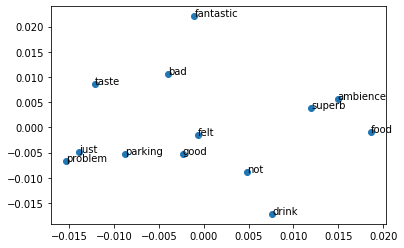

In [ ]:
from sklearn.decomposition import PCA
from matplotlib import pyplot
X = model[model.wv.vocab]
pca = PCA(n_components=2)
result = pca.fit_transform(X)
pyplot.scatter(result[:, 0], result[:, 1])
vwords = list(model.wv.vocab)
for j, word in enumerate(vwords):
  pyplot.annotate(word,xy=(result[j, 0],result[j, 1]))
pyplot.show()

# other ipynb files

cfg - 
https://colab.research.google.com/drive/1y9yIwn6X8ZyN52y8tA6M2v8mDeoDFwOz?usp=sharing
<br>
text to speech - 
https://colab.research.google.com/drive/1mR6gv2Yr5IYJpb6T_MdQfFlwJcjkPZ-l?usp=sharing
